In [6]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
import re   # Regular expressions
from sklearn.cluster import KMeans
import math
import matplotlib.pyplot as plt



In [7]:

class imagePreparation:
    
    def __init__(self, image, mask, regions) -> None:
       self.image = image
       self.mask = mask
       self.numROI = regions   # Number of regions of interest on image
       
    def setTransformation(self): 
    
        self.height, self.width = self.image.shape[:2]
        self.mask = np.zeros((self.height,self.width), np.uint8)

# Transform to gray colorspace and invert Otsu threshold the image
        #gray = cv2.cvtColor( self.image,cv2.COLOR_BGR2GRAY)
        gray = self.image
       # _, thresh = cv2.threshold(gray,0,255,cv2.THRESH_BINARY_INV+cv2.THRESH_OTSU)

### Perform opening (erosion followed by dilation)
        kernel = np.ones((2,2),np.uint8)
        # opening = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
        
        
        imgCanny = cv2.Canny(gray,100,100)
        kernel = np.ones((5,5),np.uint8)
        self.imgEroded = cv2.dilate(imgCanny,kernel,iterations=1)

        
    def setContours(self):    
        contours1, hierarchy1 = cv2.findContours(self.imgEroded, cv2.RETR_TREE,cv2.CHAIN_APPROX_NONE)

        self.IdentifiedContours = sorted(contours1, key=cv2.contourArea, reverse=True)
        for contour in self.IdentifiedContours:
            area = cv2.contourArea(contour)
            print("Contour area:", area)
            
        print('complete')        
    
    def cropping(self):
        
        for i in range(self.numROI):
            # Compute the bounding rectangle for the contour
            x, y, w, h = cv2.boundingRect(self.IdentifiedContours[i+1])  # Largest contour 0 will be the full 
                                                                       # image so we ignore that one
            cropped_image = self.image[y:y+h, x:x+w]                                                           
            cropped_mask  = self.mask[y:y+h, x:x+w]                                                                       
        # Display the cropped image
            plt.imshow(cropped_image)
            plt.axis('off')  # Optional: Turn off the axes
            plt.show()

Current Directory c:\Users\dezos\Documents\Fibres\FibreAnalysis\ImageCreation
Contour area: 875439.5
Contour area: 336651.0
Contour area: 334349.0
Contour area: 63311.0
Contour area: 62709.0
Contour area: 9060.5
Contour area: 8467.5
Contour area: 6250.5
Contour area: 4147.0
Contour area: 3766.0
Contour area: 3753.5
Contour area: 2914.0
Contour area: 2491.5
Contour area: 2247.5
Contour area: 1852.0
Contour area: 1822.0
Contour area: 1400.0
Contour area: 1321.5
Contour area: 1290.5
Contour area: 1038.0
Contour area: 982.0
Contour area: 748.5
Contour area: 630.5
Contour area: 568.5
Contour area: 383.0
Contour area: 334.5
Contour area: 309.0
Contour area: 307.5
Contour area: 296.5
Contour area: 288.5
Contour area: 284.5
Contour area: 271.0
Contour area: 270.5
Contour area: 248.5
Contour area: 240.5
Contour area: 221.5
Contour area: 218.5
Contour area: 217.0
Contour area: 208.5
Contour area: 194.5
Contour area: 194.0
Contour area: 186.5
Contour area: 185.0
Contour area: 171.0
Contour area: 

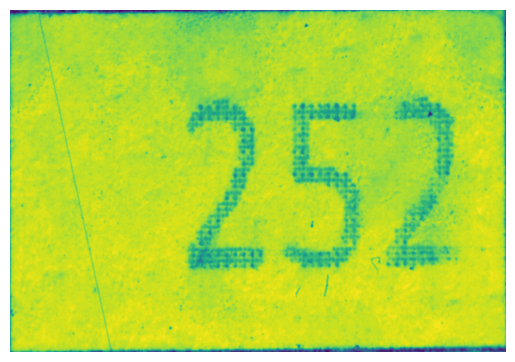

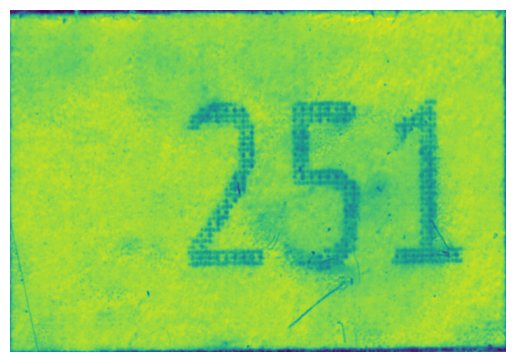

Contour area: 708726.0
Contour area: 441567.0
Contour area: 190358.0
Contour area: 10579.0
Contour area: 3329.0
Contour area: 1938.5
Contour area: 1919.5
Contour area: 1493.5
Contour area: 1492.0
Contour area: 1445.5
Contour area: 1403.0
Contour area: 1354.0
Contour area: 1328.0
Contour area: 1205.0
Contour area: 864.0
Contour area: 796.0
Contour area: 696.0
Contour area: 689.5
Contour area: 611.0
Contour area: 519.5
Contour area: 421.5
Contour area: 397.5
Contour area: 384.0
Contour area: 365.5
Contour area: 324.5
Contour area: 307.5
Contour area: 293.5
Contour area: 280.0
Contour area: 251.0
Contour area: 227.0
Contour area: 203.5
Contour area: 190.0
Contour area: 154.0
Contour area: 146.0
Contour area: 122.0
Contour area: 111.0
Contour area: 100.5
Contour area: 93.5
Contour area: 90.5
Contour area: 81.5
Contour area: 70.0
Contour area: 61.5
Contour area: 61.5
Contour area: 57.0
Contour area: 57.0
Contour area: 54.0
Contour area: 53.5
Contour area: 51.5
Contour area: 49.0
Contour are

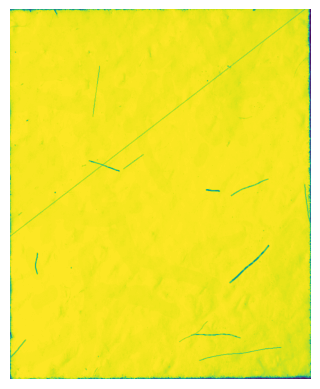

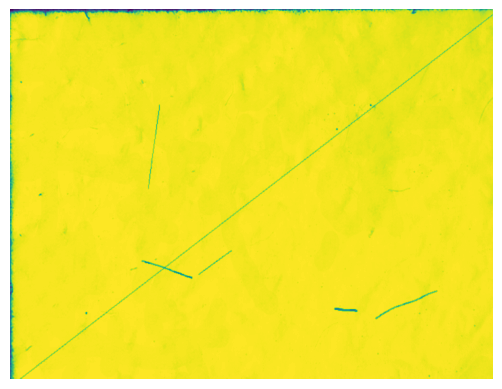

Contour area: 721009.0
Contour area: 340554.5
Contour area: 305080.5
Contour area: 9562.0
Contour area: 8976.5
Contour area: 4911.5
Contour area: 1516.0
Contour area: 1515.0
Contour area: 1206.0
Contour area: 702.0
Contour area: 520.0
Contour area: 490.5
Contour area: 256.0
Contour area: 238.5
Contour area: 234.0
Contour area: 132.5
Contour area: 130.5
Contour area: 117.0
Contour area: 95.5
Contour area: 92.5
Contour area: 90.5
Contour area: 88.0
Contour area: 86.5
Contour area: 86.0
Contour area: 82.0
Contour area: 78.0
Contour area: 60.5
Contour area: 58.5
Contour area: 57.5
Contour area: 56.5
Contour area: 47.0
Contour area: 47.0
Contour area: 45.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 33.0
Contour area: 33.

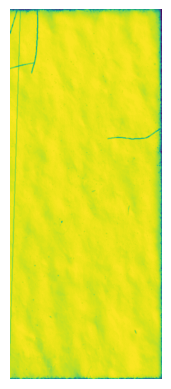

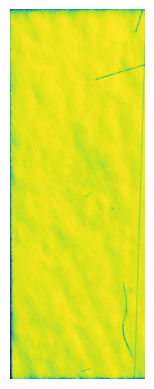

Contour area: 702700.0
Contour area: 553080.5
Contour area: 85750.0
Contour area: 11329.0
Contour area: 4665.5
Contour area: 2193.5
Contour area: 1810.0
Contour area: 1469.0
Contour area: 1429.0
Contour area: 1383.5
Contour area: 1015.5
Contour area: 827.5
Contour area: 569.0
Contour area: 551.5
Contour area: 330.0
Contour area: 323.0
Contour area: 189.0
Contour area: 130.0
Contour area: 121.0
Contour area: 103.5
Contour area: 103.5
Contour area: 92.5
Contour area: 87.5
Contour area: 85.5
Contour area: 72.0
Contour area: 67.5
Contour area: 64.5
Contour area: 55.0
Contour area: 53.5
Contour area: 53.5
Contour area: 53.0
Contour area: 52.5
Contour area: 51.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.5
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 46.5
Contour area: 46.0
Contour area: 46.0
Contour area: 42.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 37.0
Contour area: 36.0
Contour area

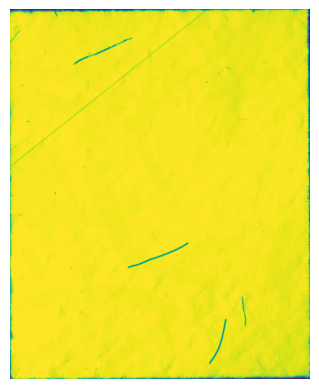

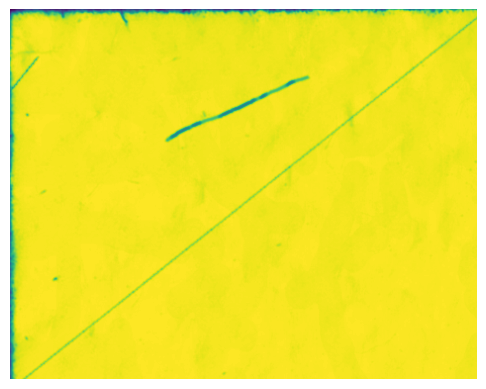

Contour area: 744496.5
Contour area: 408850.0
Contour area: 233826.0
Contour area: 4749.0
Contour area: 3273.0
Contour area: 1724.5
Contour area: 1387.0
Contour area: 1337.5
Contour area: 1078.5
Contour area: 957.0
Contour area: 701.5
Contour area: 662.0
Contour area: 545.5
Contour area: 513.0
Contour area: 508.0
Contour area: 505.5
Contour area: 373.5
Contour area: 324.0
Contour area: 297.0
Contour area: 280.5
Contour area: 276.5
Contour area: 252.0
Contour area: 245.0
Contour area: 235.5
Contour area: 159.0
Contour area: 149.0
Contour area: 125.0
Contour area: 124.0
Contour area: 112.5
Contour area: 100.5
Contour area: 87.0
Contour area: 87.0
Contour area: 85.5
Contour area: 84.0
Contour area: 81.0
Contour area: 75.0
Contour area: 71.0
Contour area: 69.0
Contour area: 64.0
Contour area: 64.0
Contour area: 56.5
Contour area: 54.0
Contour area: 52.5
Contour area: 47.0
Contour area: 45.5
Contour area: 45.0
Contour area: 45.0
Contour area: 44.0
Contour area: 42.0
Contour area: 42.0
Conto

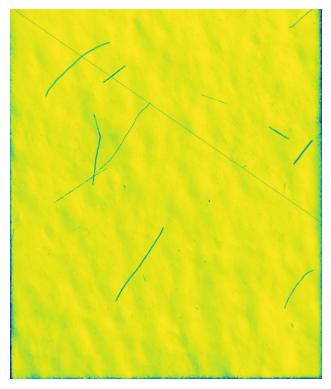

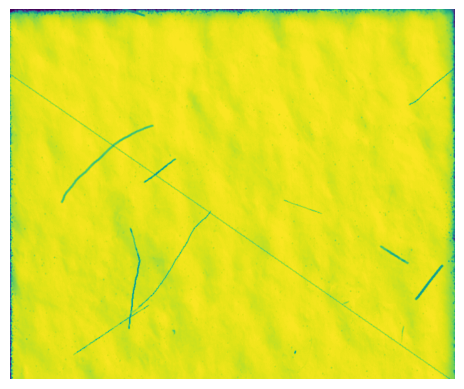

Contour area: 744396.0
Contour area: 563520.0
Contour area: 90293.5
Contour area: 15399.5
Contour area: 2065.5
Contour area: 1899.0
Contour area: 1553.0
Contour area: 1403.0
Contour area: 893.5
Contour area: 728.5
Contour area: 532.0
Contour area: 436.0
Contour area: 344.0
Contour area: 256.0
Contour area: 225.5
Contour area: 132.5
Contour area: 123.0
Contour area: 117.0
Contour area: 100.5
Contour area: 92.5
Contour area: 90.5
Contour area: 88.0
Contour area: 86.5
Contour area: 86.0
Contour area: 83.5
Contour area: 78.0
Contour area: 60.5
Contour area: 60.0
Contour area: 47.0
Contour area: 47.0
Contour area: 46.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 40.5
Contour area: 37.5
Contour area: 37.5
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 33.0
Contour area: 33.

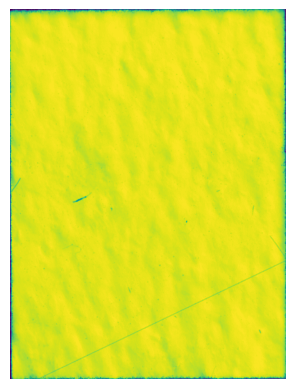

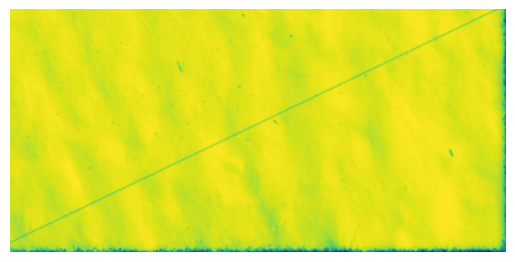

Contour area: 776197.5
Contour area: 334061.5
Contour area: 322743.0
Contour area: 16621.5
Contour area: 9705.0
Contour area: 8943.5
Contour area: 7927.0
Contour area: 7685.0
Contour area: 7301.5
Contour area: 5978.0
Contour area: 5486.5
Contour area: 4851.0
Contour area: 4679.0
Contour area: 3931.0
Contour area: 2777.0
Contour area: 1975.0
Contour area: 1573.0
Contour area: 1566.0
Contour area: 1352.0
Contour area: 1317.5
Contour area: 1117.5
Contour area: 1009.0
Contour area: 862.5
Contour area: 840.5
Contour area: 801.5
Contour area: 345.5
Contour area: 336.5
Contour area: 262.5
Contour area: 254.5
Contour area: 237.0
Contour area: 234.0
Contour area: 233.0
Contour area: 200.0
Contour area: 186.0
Contour area: 176.5
Contour area: 153.0
Contour area: 142.0
Contour area: 141.5
Contour area: 140.5
Contour area: 138.0
Contour area: 134.0
Contour area: 130.0
Contour area: 125.5
Contour area: 125.5
Contour area: 123.0
Contour area: 118.5
Contour area: 118.0
Contour area: 117.0
Contour are

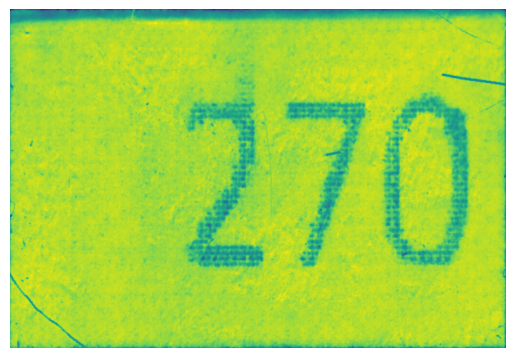

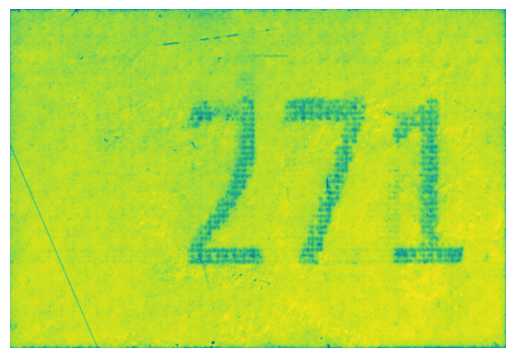

Contour area: 690776.5
Contour area: 536933.5
Contour area: 100022.0
Contour area: 11460.5
Contour area: 9461.5
Contour area: 2635.0
Contour area: 2392.0
Contour area: 2104.5
Contour area: 1986.0
Contour area: 1601.5
Contour area: 1400.5
Contour area: 1238.5
Contour area: 1034.0
Contour area: 586.0
Contour area: 477.0
Contour area: 398.0
Contour area: 381.5
Contour area: 333.5
Contour area: 302.0
Contour area: 199.0
Contour area: 187.5
Contour area: 136.5
Contour area: 126.0
Contour area: 110.5
Contour area: 105.0
Contour area: 100.5
Contour area: 90.5
Contour area: 87.5
Contour area: 86.0
Contour area: 70.0
Contour area: 69.0
Contour area: 67.5
Contour area: 59.5
Contour area: 57.0
Contour area: 55.0
Contour area: 54.5
Contour area: 52.5
Contour area: 52.0
Contour area: 51.5
Contour area: 51.5
Contour area: 51.0
Contour area: 48.5
Contour area: 48.5
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.0
Cont

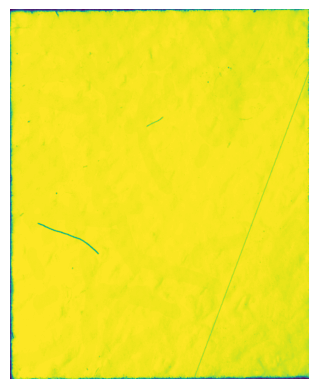

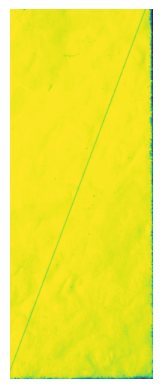

Contour area: 719984.0
Contour area: 569733.0
Contour area: 82106.5
Contour area: 10385.5
Contour area: 1352.5
Contour area: 1299.0
Contour area: 1137.0
Contour area: 693.0
Contour area: 665.0
Contour area: 575.0
Contour area: 502.5
Contour area: 459.5
Contour area: 347.0
Contour area: 265.5
Contour area: 234.5
Contour area: 171.0
Contour area: 152.0
Contour area: 138.0
Contour area: 125.5
Contour area: 118.0
Contour area: 101.5
Contour area: 93.5
Contour area: 87.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 69.0
Contour area: 69.0
Contour area: 66.5
Contour area: 61.0
Contour area: 58.5
Contour area: 57.0
Contour area: 52.5
Contour area: 47.0
Contour area: 45.5
Contour area: 44.0
Contour area: 44.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.5
Contour area: 41.5
Contour area: 41.0
Contour area: 40.5
Contour area: 40.5
Contour area: 40.0
Contour area: 40

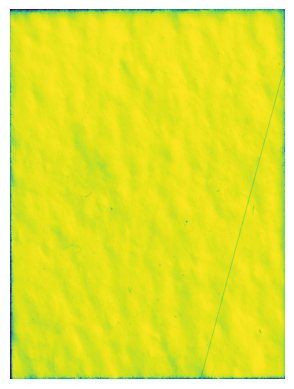

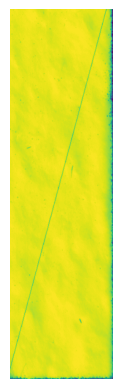

Contour area: 765381.5
Contour area: 340134.5
Contour area: 279982.5
Contour area: 44168.0
Contour area: 10629.5
Contour area: 9153.0
Contour area: 8739.5
Contour area: 7956.5
Contour area: 7245.0
Contour area: 6378.0
Contour area: 5702.5
Contour area: 5581.5
Contour area: 2868.5
Contour area: 1770.0
Contour area: 1681.0
Contour area: 1094.0
Contour area: 1012.0
Contour area: 930.5
Contour area: 654.0
Contour area: 518.0
Contour area: 476.5
Contour area: 413.0
Contour area: 363.5
Contour area: 329.0
Contour area: 298.0
Contour area: 194.5
Contour area: 194.5
Contour area: 163.0
Contour area: 153.0
Contour area: 142.0
Contour area: 142.0
Contour area: 138.0
Contour area: 126.5
Contour area: 125.0
Contour area: 123.5
Contour area: 118.5
Contour area: 118.0
Contour area: 109.0
Contour area: 106.5
Contour area: 106.5
Contour area: 106.5
Contour area: 106.0
Contour area: 104.5
Contour area: 103.0
Contour area: 101.0
Contour area: 96.5
Contour area: 95.5
Contour area: 94.5
Contour area: 92.0

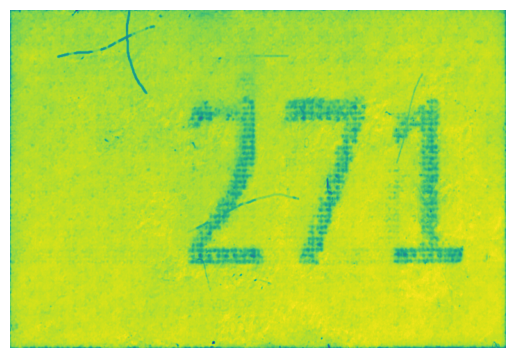

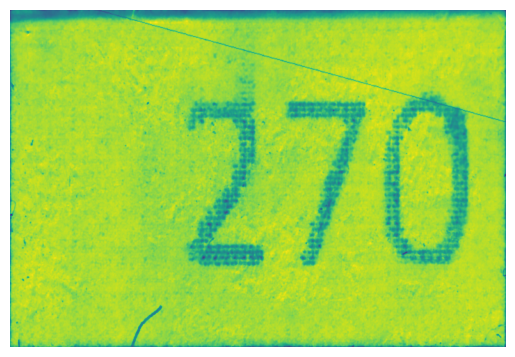

Contour area: 764332.0
Contour area: 344268.5
Contour area: 267646.5
Contour area: 66462.0
Contour area: 11027.5
Contour area: 9591.5
Contour area: 7536.5
Contour area: 7127.0
Contour area: 4792.5
Contour area: 3643.0
Contour area: 2138.0
Contour area: 2063.5
Contour area: 1530.0
Contour area: 904.5
Contour area: 799.5
Contour area: 795.5
Contour area: 779.0
Contour area: 764.0
Contour area: 720.0
Contour area: 617.5
Contour area: 502.0
Contour area: 431.0
Contour area: 375.5
Contour area: 355.0
Contour area: 207.5
Contour area: 192.5
Contour area: 184.0
Contour area: 177.0
Contour area: 170.0
Contour area: 170.0
Contour area: 168.0
Contour area: 164.5
Contour area: 162.0
Contour area: 162.0
Contour area: 159.5
Contour area: 156.5
Contour area: 150.0
Contour area: 141.5
Contour area: 140.0
Contour area: 131.5
Contour area: 130.5
Contour area: 129.0
Contour area: 128.5
Contour area: 127.5
Contour area: 121.0
Contour area: 119.0
Contour area: 115.0
Contour area: 109.5
Contour area: 109.0

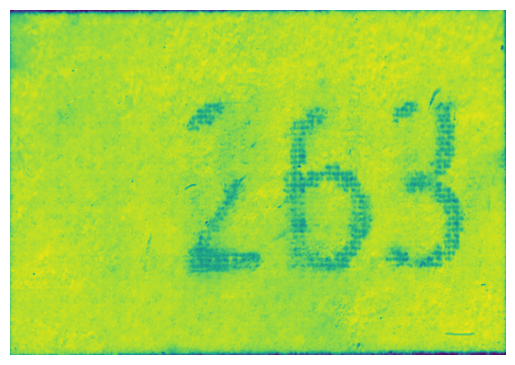

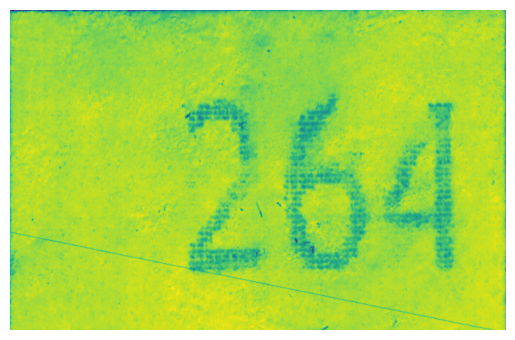

Contour area: 873555.5
Contour area: 325744.0
Contour area: 325652.0
Contour area: 62417.0
Contour area: 62092.5
Contour area: 15450.0
Contour area: 10709.5
Contour area: 6537.0
Contour area: 4007.0
Contour area: 3427.5
Contour area: 1999.0
Contour area: 957.5
Contour area: 734.5
Contour area: 650.5
Contour area: 409.5
Contour area: 335.5
Contour area: 309.5
Contour area: 308.5
Contour area: 268.0
Contour area: 228.0
Contour area: 195.0
Contour area: 189.0
Contour area: 177.5
Contour area: 164.5
Contour area: 160.0
Contour area: 154.5
Contour area: 148.5
Contour area: 144.5
Contour area: 139.0
Contour area: 137.0
Contour area: 120.5
Contour area: 119.0
Contour area: 118.5
Contour area: 118.5
Contour area: 115.0
Contour area: 115.0
Contour area: 106.0
Contour area: 105.5
Contour area: 105.0
Contour area: 104.5
Contour area: 104.5
Contour area: 103.0
Contour area: 101.5
Contour area: 101.0
Contour area: 99.0
Contour area: 97.5
Contour area: 95.5
Contour area: 93.5
Contour area: 92.5
Cont

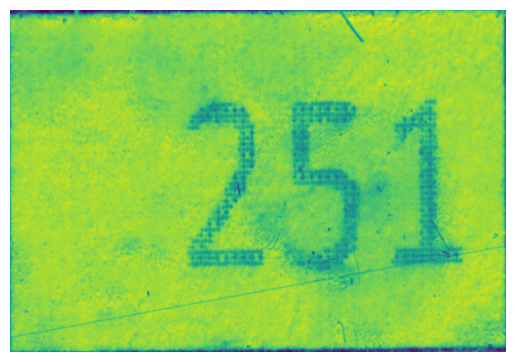

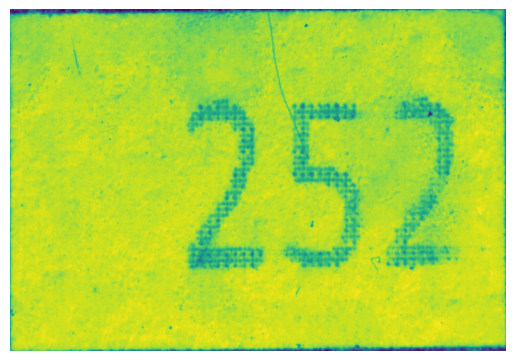

Contour area: 755471.0
Contour area: 653254.0
Contour area: 4756.0
Contour area: 4564.0
Contour area: 3250.0
Contour area: 2920.5
Contour area: 1654.5
Contour area: 1385.0
Contour area: 1367.5
Contour area: 1357.5
Contour area: 1255.5
Contour area: 1170.5
Contour area: 1143.0
Contour area: 1026.5
Contour area: 896.5
Contour area: 873.5
Contour area: 804.0
Contour area: 776.0
Contour area: 743.0
Contour area: 711.0
Contour area: 581.5
Contour area: 541.0
Contour area: 513.5
Contour area: 497.0
Contour area: 336.0
Contour area: 276.0
Contour area: 256.0
Contour area: 236.5
Contour area: 230.5
Contour area: 172.5
Contour area: 159.5
Contour area: 151.0
Contour area: 127.0
Contour area: 121.5
Contour area: 121.0
Contour area: 99.0
Contour area: 89.0
Contour area: 87.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 70.0
Contour area: 58.5
Contour area: 57.5
Contour area: 47.5
Contour area: 47.0
Contour area: 45.0
Contour area: 44.0
Contour area: 44.0
Contour area: 42

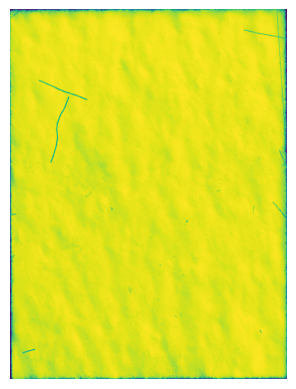

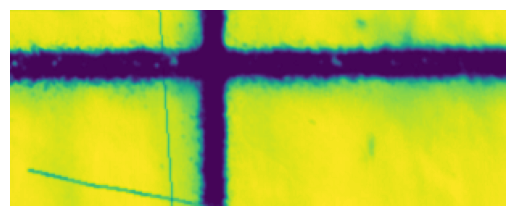

Contour area: 704686.5
Contour area: 500447.0
Contour area: 135839.0
Contour area: 13583.0
Contour area: 2348.0
Contour area: 2103.0
Contour area: 1989.0
Contour area: 1972.5
Contour area: 1621.0
Contour area: 1359.0
Contour area: 1281.0
Contour area: 1238.0
Contour area: 983.5
Contour area: 983.0
Contour area: 804.5
Contour area: 582.0
Contour area: 460.0
Contour area: 380.5
Contour area: 333.5
Contour area: 199.0
Contour area: 190.5
Contour area: 136.5
Contour area: 126.0
Contour area: 110.5
Contour area: 105.0
Contour area: 100.5
Contour area: 90.5
Contour area: 87.5
Contour area: 86.0
Contour area: 70.0
Contour area: 68.5
Contour area: 67.5
Contour area: 62.0
Contour area: 57.0
Contour area: 56.5
Contour area: 54.5
Contour area: 54.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 51.5
Contour area: 51.5
Contour area: 48.5
Contour area: 48.5
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.5
Conto

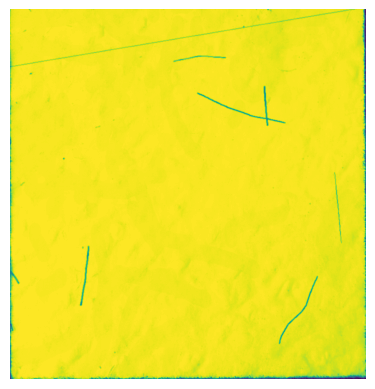

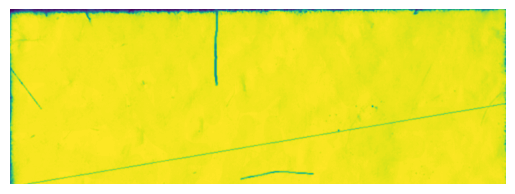

Contour area: 894860.0
Contour area: 336480.0
Contour area: 331671.0
Contour area: 63491.5
Contour area: 63045.0
Contour area: 23737.5
Contour area: 8511.5
Contour area: 8290.5
Contour area: 6945.5
Contour area: 3374.5
Contour area: 3069.5
Contour area: 2840.0
Contour area: 2715.0
Contour area: 2173.0
Contour area: 1756.5
Contour area: 1470.0
Contour area: 1466.0
Contour area: 1269.0
Contour area: 998.0
Contour area: 899.0
Contour area: 877.5
Contour area: 629.0
Contour area: 582.0
Contour area: 549.5
Contour area: 546.5
Contour area: 523.5
Contour area: 480.5
Contour area: 421.5
Contour area: 390.0
Contour area: 356.0
Contour area: 329.5
Contour area: 309.5
Contour area: 293.0
Contour area: 292.5
Contour area: 291.5
Contour area: 291.5
Contour area: 280.0
Contour area: 276.0
Contour area: 270.5
Contour area: 254.0
Contour area: 227.5
Contour area: 224.5
Contour area: 219.5
Contour area: 217.0
Contour area: 202.0
Contour area: 197.0
Contour area: 194.5
Contour area: 189.5
Contour area:

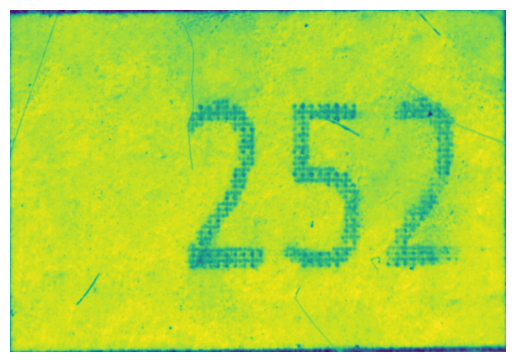

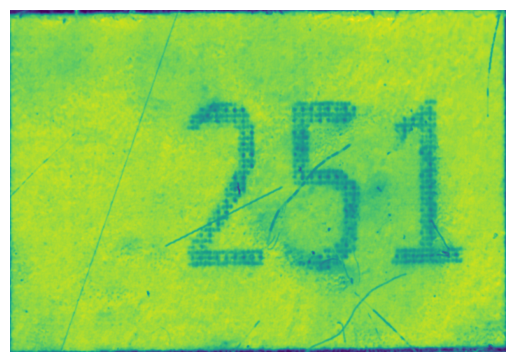

Contour area: 756062.5
Contour area: 337571.5
Contour area: 326245.0
Contour area: 13572.0
Contour area: 10967.0
Contour area: 8380.0
Contour area: 6109.5
Contour area: 5863.5
Contour area: 5737.5
Contour area: 4031.0
Contour area: 3309.0
Contour area: 3300.0
Contour area: 3039.0
Contour area: 2446.0
Contour area: 1895.0
Contour area: 1660.0
Contour area: 1195.5
Contour area: 901.0
Contour area: 551.5
Contour area: 516.0
Contour area: 414.0
Contour area: 402.5
Contour area: 396.5
Contour area: 390.0
Contour area: 378.0
Contour area: 315.5
Contour area: 278.0
Contour area: 271.5
Contour area: 242.0
Contour area: 227.0
Contour area: 227.0
Contour area: 208.5
Contour area: 202.0
Contour area: 193.0
Contour area: 191.0
Contour area: 175.0
Contour area: 175.0
Contour area: 167.0
Contour area: 164.0
Contour area: 152.0
Contour area: 149.5
Contour area: 147.0
Contour area: 138.5
Contour area: 138.5
Contour area: 137.0
Contour area: 136.0
Contour area: 135.0
Contour area: 132.0
Contour area: 1

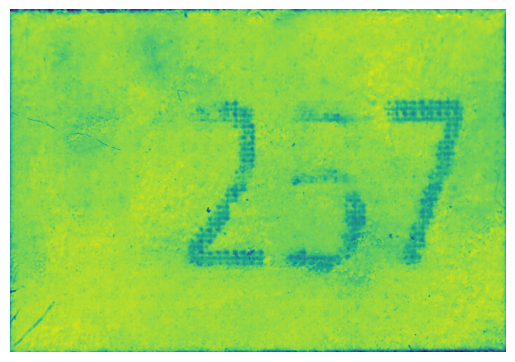

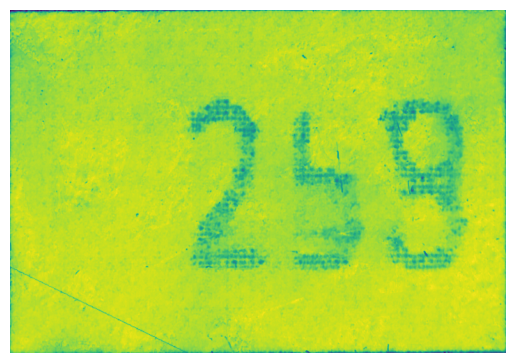

Contour area: 715055.0
Contour area: 632166.5
Contour area: 12858.5
Contour area: 6664.5
Contour area: 5301.0
Contour area: 1861.0
Contour area: 1352.5
Contour area: 1295.0
Contour area: 1070.5
Contour area: 1026.0
Contour area: 947.0
Contour area: 870.0
Contour area: 674.0
Contour area: 605.5
Contour area: 598.5
Contour area: 526.5
Contour area: 427.5
Contour area: 417.0
Contour area: 406.0
Contour area: 401.5
Contour area: 354.0
Contour area: 340.0
Contour area: 293.5
Contour area: 274.5
Contour area: 247.5
Contour area: 237.0
Contour area: 233.5
Contour area: 216.0
Contour area: 210.0
Contour area: 205.5
Contour area: 199.5
Contour area: 143.0
Contour area: 115.5
Contour area: 110.5
Contour area: 110.0
Contour area: 104.0
Contour area: 77.5
Contour area: 71.0
Contour area: 68.0
Contour area: 66.0
Contour area: 58.5
Contour area: 53.0
Contour area: 50.5
Contour area: 45.0
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5

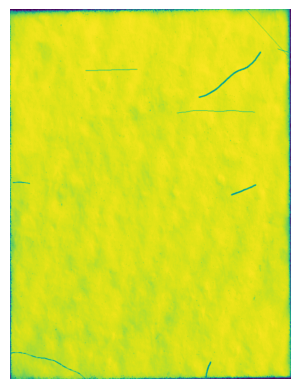

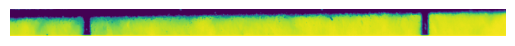

Contour area: 714252.0
Contour area: 619717.5
Contour area: 33959.0
Contour area: 11300.5
Contour area: 1481.0
Contour area: 1215.5
Contour area: 1011.5
Contour area: 951.5
Contour area: 729.0
Contour area: 518.5
Contour area: 284.0
Contour area: 260.0
Contour area: 229.0
Contour area: 179.0
Contour area: 143.5
Contour area: 120.0
Contour area: 113.5
Contour area: 109.0
Contour area: 92.5
Contour area: 90.5
Contour area: 89.0
Contour area: 86.5
Contour area: 82.0
Contour area: 79.5
Contour area: 70.0
Contour area: 60.5
Contour area: 60.0
Contour area: 58.5
Contour area: 52.5
Contour area: 51.5
Contour area: 42.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.0
Contour area: 41.0
Contour area: 40.5
Contour area: 39.0
Contour area: 39.0
Contour area: 39.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0


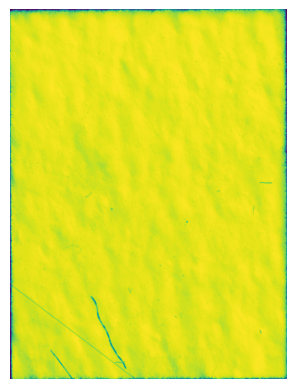

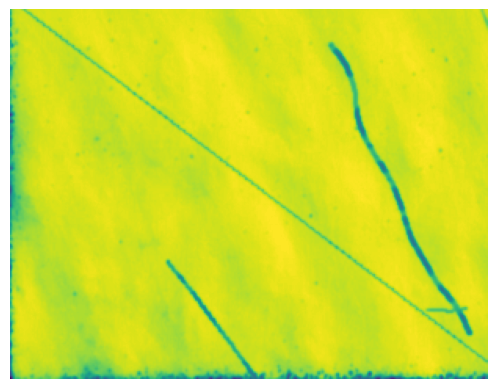

Contour area: 820602.0
Contour area: 341489.5
Contour area: 337024.5
Contour area: 34393.5
Contour area: 22437.0
Contour area: 13396.0
Contour area: 7629.0
Contour area: 6140.0
Contour area: 5544.0
Contour area: 5505.0
Contour area: 3706.5
Contour area: 3265.0
Contour area: 3190.0
Contour area: 3011.0
Contour area: 2295.0
Contour area: 2248.0
Contour area: 1533.0
Contour area: 1180.5
Contour area: 627.0
Contour area: 541.0
Contour area: 403.5
Contour area: 392.5
Contour area: 388.0
Contour area: 387.0
Contour area: 377.5
Contour area: 356.5
Contour area: 354.0
Contour area: 351.5
Contour area: 336.5
Contour area: 326.5
Contour area: 324.5
Contour area: 311.5
Contour area: 268.0
Contour area: 252.5
Contour area: 240.0
Contour area: 227.0
Contour area: 201.5
Contour area: 197.5
Contour area: 196.5
Contour area: 188.0
Contour area: 185.5
Contour area: 185.0
Contour area: 184.5
Contour area: 175.0
Contour area: 167.0
Contour area: 166.0
Contour area: 165.5
Contour area: 162.5
Contour area:

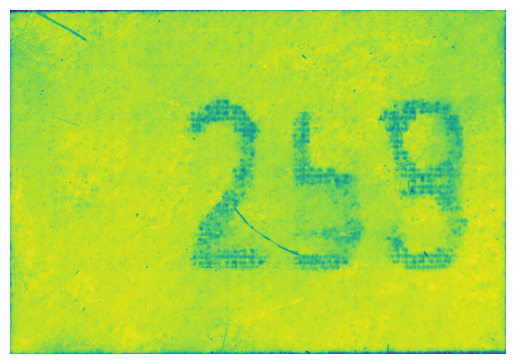

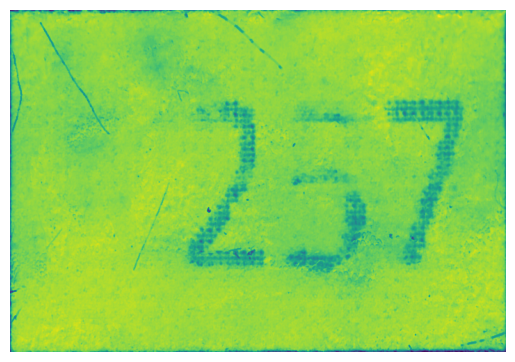

Contour area: 767684.5
Contour area: 340913.0
Contour area: 279725.5
Contour area: 54141.5
Contour area: 13555.5
Contour area: 11779.0
Contour area: 11592.5
Contour area: 10144.5
Contour area: 9614.0
Contour area: 9244.5
Contour area: 9186.5
Contour area: 9170.0
Contour area: 8611.0
Contour area: 1206.0
Contour area: 366.0
Contour area: 321.0
Contour area: 286.5
Contour area: 273.5
Contour area: 263.0
Contour area: 182.5
Contour area: 168.5
Contour area: 159.5
Contour area: 155.0
Contour area: 154.5
Contour area: 150.0
Contour area: 140.0
Contour area: 135.0
Contour area: 134.0
Contour area: 132.5
Contour area: 127.5
Contour area: 122.5
Contour area: 121.5
Contour area: 121.5
Contour area: 118.5
Contour area: 117.0
Contour area: 114.0
Contour area: 110.5
Contour area: 109.0
Contour area: 108.0
Contour area: 105.5
Contour area: 105.5
Contour area: 104.0
Contour area: 101.0
Contour area: 99.5
Contour area: 97.5
Contour area: 96.0
Contour area: 94.5
Contour area: 92.5
Contour area: 92.0
C

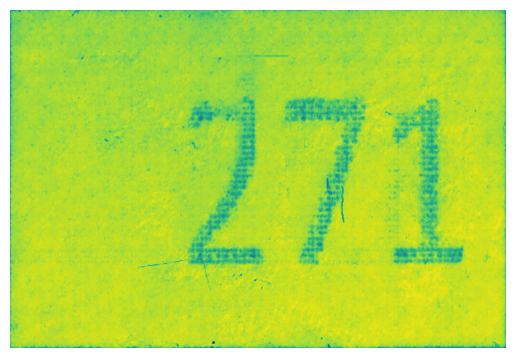

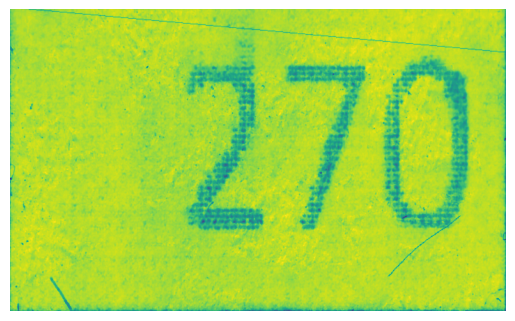

Contour area: 730141.5
Contour area: 475126.0
Contour area: 152911.5
Contour area: 7051.5
Contour area: 6110.5
Contour area: 1725.5
Contour area: 1248.5
Contour area: 1233.0
Contour area: 1178.5
Contour area: 1071.0
Contour area: 982.0
Contour area: 944.5
Contour area: 905.0
Contour area: 807.0
Contour area: 746.5
Contour area: 606.0
Contour area: 474.0
Contour area: 450.5
Contour area: 434.0
Contour area: 359.0
Contour area: 326.0
Contour area: 272.5
Contour area: 255.5
Contour area: 143.5
Contour area: 134.0
Contour area: 127.5
Contour area: 120.0
Contour area: 109.0
Contour area: 94.0
Contour area: 60.0
Contour area: 60.0
Contour area: 60.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 39.5
Contour area: 36.0
Contour area: 36.0
Contour area: 32.5
Contour area: 30.0
Contour area: 29.0
Contour area: 28.5
Contour area: 24.0
Contour area: 24.0
Contour area: 24.0
Contour area: 24.0
Contour area: 20.5
Contour area: 20.0
Contour area: 20.0
Contour area: 20.0
Contou

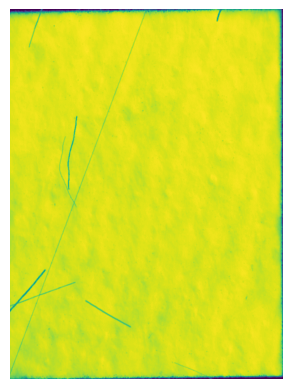

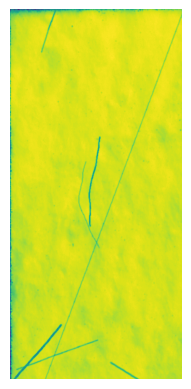

Contour area: 707585.5
Contour area: 596826.5
Contour area: 17740.5
Contour area: 15197.5
Contour area: 4148.5
Contour area: 2004.5
Contour area: 1874.0
Contour area: 1708.5
Contour area: 1507.0
Contour area: 690.0
Contour area: 644.5
Contour area: 433.0
Contour area: 396.5
Contour area: 356.5
Contour area: 197.0
Contour area: 180.0
Contour area: 163.0
Contour area: 142.0
Contour area: 132.5
Contour area: 128.5
Contour area: 99.0
Contour area: 97.5
Contour area: 91.0
Contour area: 90.0
Contour area: 88.0
Contour area: 82.5
Contour area: 78.0
Contour area: 77.0
Contour area: 76.0
Contour area: 67.0
Contour area: 63.5
Contour area: 55.5
Contour area: 54.5
Contour area: 53.5
Contour area: 51.5
Contour area: 50.5
Contour area: 49.5
Contour area: 48.0
Contour area: 47.5
Contour area: 47.0
Contour area: 47.0
Contour area: 45.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.0
Contour area: 38.0
Contour area: 37.0
Contour area: 36.0
Contour area: 3

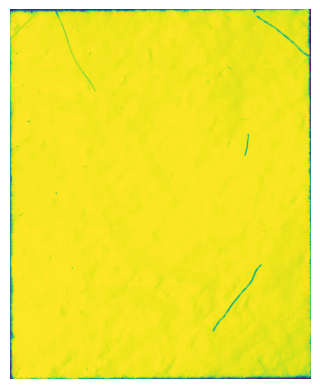

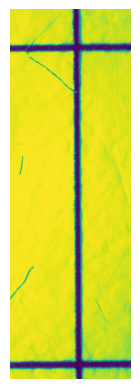

Contour area: 874493.5
Contour area: 332009.5
Contour area: 283190.0
Contour area: 63420.5
Contour area: 62388.5
Contour area: 31207.0
Contour area: 11808.5
Contour area: 10721.0
Contour area: 7233.0
Contour area: 6634.0
Contour area: 4207.5
Contour area: 4021.0
Contour area: 2000.5
Contour area: 1034.0
Contour area: 971.5
Contour area: 955.0
Contour area: 457.5
Contour area: 435.5
Contour area: 367.0
Contour area: 343.0
Contour area: 335.5
Contour area: 308.5
Contour area: 300.0
Contour area: 290.0
Contour area: 228.0
Contour area: 212.5
Contour area: 195.0
Contour area: 189.0
Contour area: 177.5
Contour area: 159.0
Contour area: 150.5
Contour area: 150.5
Contour area: 146.5
Contour area: 145.0
Contour area: 144.5
Contour area: 142.0
Contour area: 139.0
Contour area: 138.5
Contour area: 136.0
Contour area: 135.5
Contour area: 120.5
Contour area: 120.5
Contour area: 119.0
Contour area: 118.5
Contour area: 115.0
Contour area: 106.0
Contour area: 105.5
Contour area: 105.5
Contour area: 1

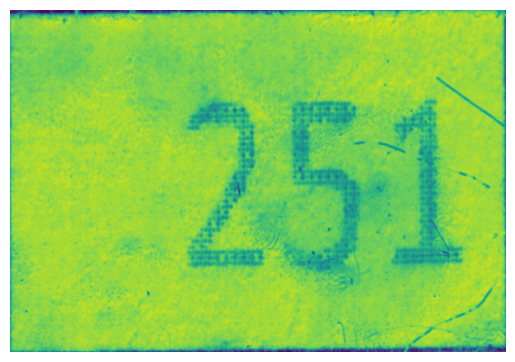

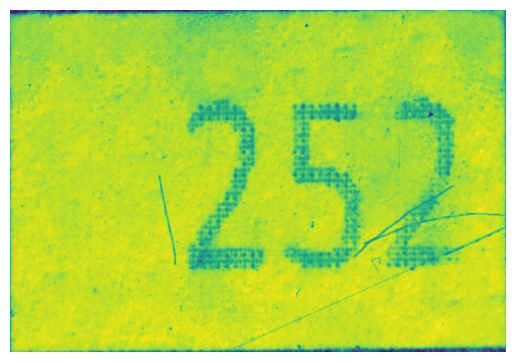

Contour area: 711066.0
Contour area: 504739.0
Contour area: 88968.5
Contour area: 14046.5
Contour area: 10060.0
Contour area: 4397.0
Contour area: 3146.5
Contour area: 1967.5
Contour area: 1957.5
Contour area: 1691.0
Contour area: 1537.0
Contour area: 1472.5
Contour area: 1276.5
Contour area: 1193.0
Contour area: 958.5
Contour area: 944.0
Contour area: 790.0
Contour area: 601.0
Contour area: 498.0
Contour area: 489.0
Contour area: 464.5
Contour area: 437.0
Contour area: 368.0
Contour area: 367.0
Contour area: 344.0
Contour area: 294.0
Contour area: 194.5
Contour area: 180.5
Contour area: 163.0
Contour area: 143.0
Contour area: 132.5
Contour area: 105.5
Contour area: 97.5
Contour area: 97.5
Contour area: 97.0
Contour area: 92.5
Contour area: 91.0
Contour area: 88.0
Contour area: 82.5
Contour area: 66.5
Contour area: 62.5
Contour area: 54.5
Contour area: 53.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 47

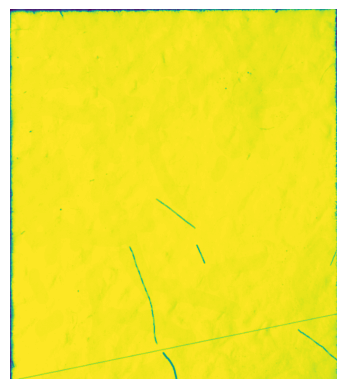

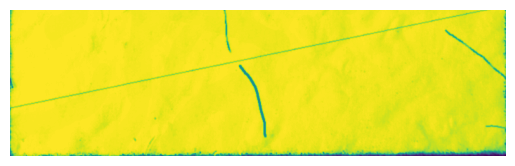

Contour area: 749535.5
Contour area: 344545.0
Contour area: 342260.0
Contour area: 4479.5
Contour area: 3877.5
Contour area: 2281.5
Contour area: 2234.0
Contour area: 1816.0
Contour area: 1654.0
Contour area: 1348.0
Contour area: 1303.0
Contour area: 1188.0
Contour area: 831.0
Contour area: 752.5
Contour area: 727.0
Contour area: 701.5
Contour area: 604.0
Contour area: 581.0
Contour area: 573.5
Contour area: 528.0
Contour area: 521.0
Contour area: 493.0
Contour area: 464.0
Contour area: 424.5
Contour area: 393.5
Contour area: 373.5
Contour area: 357.5
Contour area: 354.5
Contour area: 341.0
Contour area: 300.5
Contour area: 290.5
Contour area: 287.5
Contour area: 272.5
Contour area: 267.0
Contour area: 261.0
Contour area: 252.5
Contour area: 250.5
Contour area: 239.5
Contour area: 237.5
Contour area: 236.5
Contour area: 232.5
Contour area: 228.0
Contour area: 226.5
Contour area: 210.5
Contour area: 208.5
Contour area: 202.5
Contour area: 202.0
Contour area: 201.5
Contour area: 193.5
Co

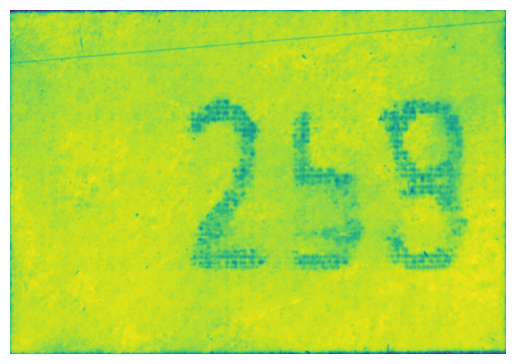

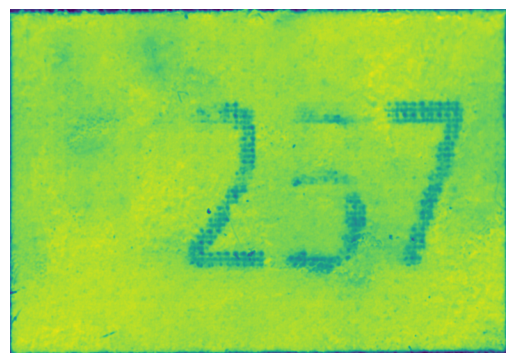

Contour area: 735532.5
Contour area: 397385.0
Contour area: 253070.5
Contour area: 15039.5
Contour area: 6774.5
Contour area: 4968.5
Contour area: 3860.5
Contour area: 3206.0
Contour area: 1835.5
Contour area: 1833.5
Contour area: 1594.0
Contour area: 1541.5
Contour area: 1445.0
Contour area: 1394.5
Contour area: 1312.0
Contour area: 1168.0
Contour area: 1161.0
Contour area: 857.0
Contour area: 763.0
Contour area: 720.5
Contour area: 510.0
Contour area: 406.0
Contour area: 324.0
Contour area: 230.5
Contour area: 219.0
Contour area: 218.5
Contour area: 203.0
Contour area: 166.5
Contour area: 144.0
Contour area: 123.5
Contour area: 121.0
Contour area: 115.5
Contour area: 95.0
Contour area: 89.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 70.0
Contour area: 60.5
Contour area: 60.0
Contour area: 58.5
Contour area: 47.0
Contour area: 46.5
Contour area: 45.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area:

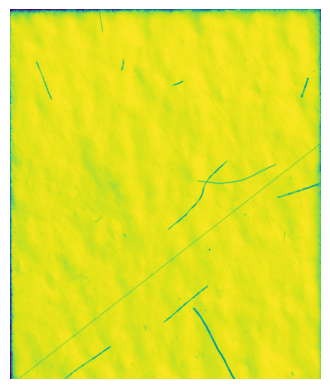

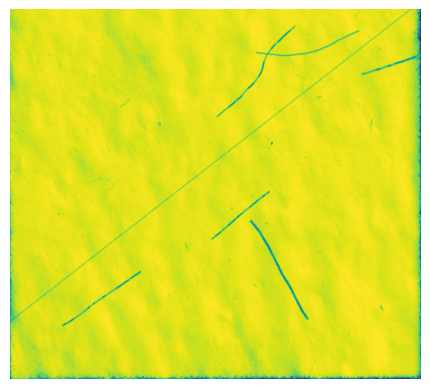

Contour area: 711047.0
Contour area: 333833.5
Contour area: 308343.5
Contour area: 13334.0
Contour area: 1259.0
Contour area: 1225.5
Contour area: 1120.0
Contour area: 1010.5
Contour area: 1006.0
Contour area: 984.0
Contour area: 877.0
Contour area: 724.5
Contour area: 483.5
Contour area: 467.5
Contour area: 453.0
Contour area: 429.0
Contour area: 413.0
Contour area: 402.5
Contour area: 299.0
Contour area: 295.5
Contour area: 292.5
Contour area: 281.0
Contour area: 274.5
Contour area: 270.5
Contour area: 251.0
Contour area: 245.0
Contour area: 239.0
Contour area: 221.0
Contour area: 208.0
Contour area: 139.0
Contour area: 114.0
Contour area: 109.0
Contour area: 106.5
Contour area: 103.5
Contour area: 77.5
Contour area: 69.5
Contour area: 68.0
Contour area: 54.0
Contour area: 53.5
Contour area: 48.5
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 40.5
Contour area: 40.5
Contour area: 40.0
Contour area: 37.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0


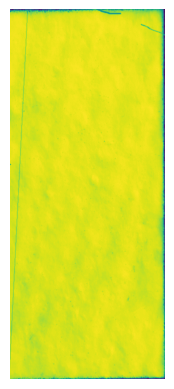

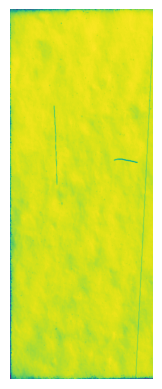

Contour area: 712760.0
Contour area: 520223.5
Contour area: 51865.5
Contour area: 21431.0
Contour area: 13672.0
Contour area: 10873.5
Contour area: 7291.5
Contour area: 4270.5
Contour area: 3736.5
Contour area: 3449.5
Contour area: 2799.5
Contour area: 2073.0
Contour area: 2052.5
Contour area: 1799.5
Contour area: 1708.5
Contour area: 877.5
Contour area: 864.0
Contour area: 837.0
Contour area: 397.5
Contour area: 393.5
Contour area: 393.5
Contour area: 298.5
Contour area: 252.5
Contour area: 210.0
Contour area: 183.0
Contour area: 134.5
Contour area: 132.5
Contour area: 110.0
Contour area: 94.5
Contour area: 93.0
Contour area: 92.0
Contour area: 88.0
Contour area: 86.0
Contour area: 82.0
Contour area: 78.5
Contour area: 78.0
Contour area: 75.0
Contour area: 74.0
Contour area: 68.0
Contour area: 65.0
Contour area: 56.0
Contour area: 54.5
Contour area: 52.5
Contour area: 51.0
Contour area: 49.5
Contour area: 49.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 47.0

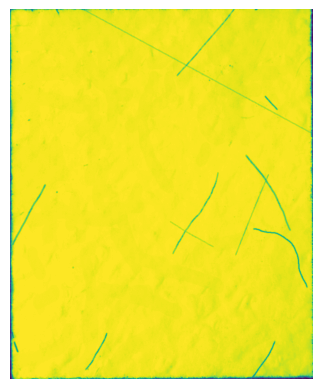

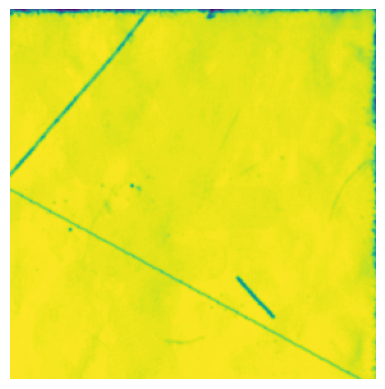

Contour area: 739389.5
Contour area: 650951.0
Contour area: 10532.5
Contour area: 6345.5
Contour area: 4217.5
Contour area: 1834.0
Contour area: 1787.0
Contour area: 1592.0
Contour area: 1492.0
Contour area: 1145.0
Contour area: 1134.0
Contour area: 1111.5
Contour area: 773.0
Contour area: 759.0
Contour area: 736.0
Contour area: 668.0
Contour area: 642.5
Contour area: 491.0
Contour area: 339.5
Contour area: 284.0
Contour area: 225.5
Contour area: 217.5
Contour area: 113.0
Contour area: 106.5
Contour area: 100.5
Contour area: 92.5
Contour area: 87.5
Contour area: 84.0
Contour area: 83.0
Contour area: 82.0
Contour area: 81.5
Contour area: 79.0
Contour area: 60.5
Contour area: 60.0
Contour area: 50.5
Contour area: 48.5
Contour area: 47.0
Contour area: 46.5
Contour area: 46.5
Contour area: 46.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour 

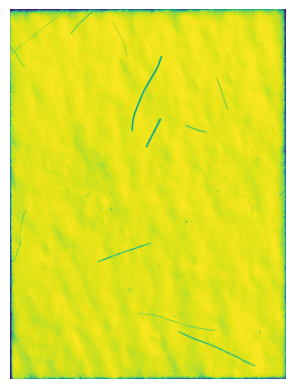

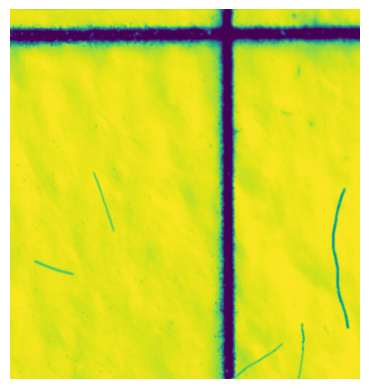

Contour area: 757806.0
Contour area: 321142.5
Contour area: 313886.0
Contour area: 19832.5
Contour area: 11429.0
Contour area: 10190.5
Contour area: 9445.5
Contour area: 6460.5
Contour area: 6206.0
Contour area: 4116.0
Contour area: 3143.0
Contour area: 2652.0
Contour area: 1923.0
Contour area: 1764.5
Contour area: 1308.0
Contour area: 1001.5
Contour area: 728.0
Contour area: 552.0
Contour area: 538.5
Contour area: 521.5
Contour area: 507.0
Contour area: 443.0
Contour area: 425.0
Contour area: 405.5
Contour area: 364.5
Contour area: 343.5
Contour area: 277.5
Contour area: 241.0
Contour area: 236.0
Contour area: 221.0
Contour area: 213.5
Contour area: 208.0
Contour area: 200.0
Contour area: 197.0
Contour area: 191.0
Contour area: 189.5
Contour area: 183.5
Contour area: 181.5
Contour area: 170.5
Contour area: 168.5
Contour area: 168.0
Contour area: 156.0
Contour area: 151.5
Contour area: 145.0
Contour area: 138.5
Contour area: 136.0
Contour area: 135.0
Contour area: 131.0
Contour area: 1

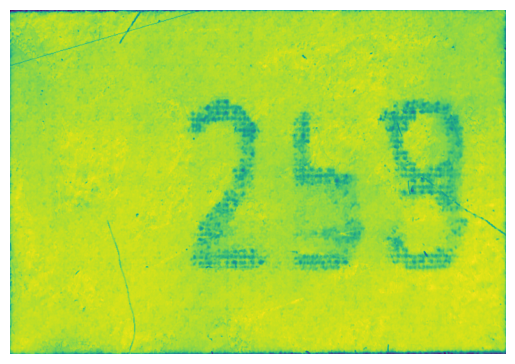

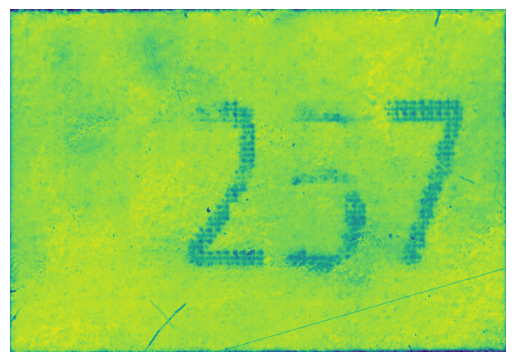

Contour area: 738101.0
Contour area: 622662.5
Contour area: 34288.0
Contour area: 13382.0
Contour area: 1597.5
Contour area: 1148.5
Contour area: 735.0
Contour area: 670.0
Contour area: 550.0
Contour area: 462.0
Contour area: 225.5
Contour area: 217.5
Contour area: 113.0
Contour area: 106.5
Contour area: 100.5
Contour area: 92.5
Contour area: 86.5
Contour area: 84.0
Contour area: 83.0
Contour area: 82.0
Contour area: 81.5
Contour area: 80.0
Contour area: 60.5
Contour area: 60.0
Contour area: 55.5
Contour area: 48.5
Contour area: 46.5
Contour area: 46.0
Contour area: 42.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 37.5
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 33.0
Contour area: 33.0
Contour area: 32.5
Contour area: 32.5
Contour area: 28.0
Contour area: 24.5
Cont

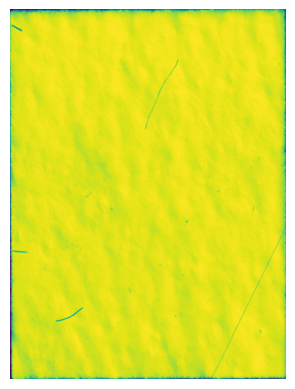

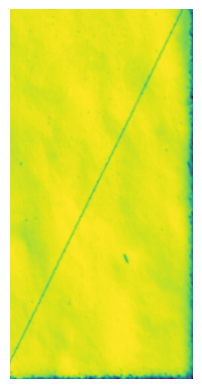

Contour area: 765211.5
Contour area: 333625.0
Contour area: 327046.5
Contour area: 12278.0
Contour area: 11448.5
Contour area: 11317.0
Contour area: 10945.0
Contour area: 9239.5
Contour area: 8665.0
Contour area: 8565.5
Contour area: 8438.0
Contour area: 8178.0
Contour area: 7986.5
Contour area: 2966.0
Contour area: 2024.0
Contour area: 1638.0
Contour area: 1205.0
Contour area: 840.0
Contour area: 825.0
Contour area: 419.0
Contour area: 353.5
Contour area: 276.0
Contour area: 275.0
Contour area: 255.5
Contour area: 214.0
Contour area: 202.5
Contour area: 170.5
Contour area: 159.5
Contour area: 155.0
Contour area: 151.5
Contour area: 150.0
Contour area: 144.0
Contour area: 143.5
Contour area: 134.0
Contour area: 127.5
Contour area: 124.0
Contour area: 119.0
Contour area: 117.0
Contour area: 110.5
Contour area: 108.5
Contour area: 106.0
Contour area: 104.5
Contour area: 99.5
Contour area: 99.5
Contour area: 99.0
Contour area: 94.5
Contour area: 94.5
Contour area: 93.5
Contour area: 92.0


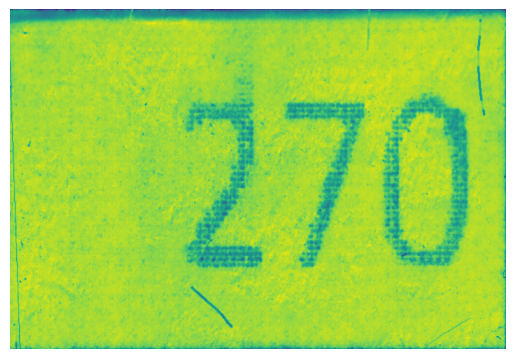

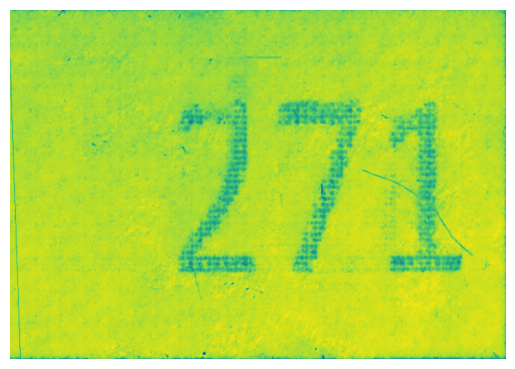

Contour area: 777271.5
Contour area: 341468.0
Contour area: 172052.5
Contour area: 121401.0
Contour area: 11737.5
Contour area: 8754.5
Contour area: 8738.0
Contour area: 8696.5
Contour area: 8557.0
Contour area: 6585.5
Contour area: 5164.5
Contour area: 4296.0
Contour area: 2620.0
Contour area: 1333.0
Contour area: 1133.0
Contour area: 1074.0
Contour area: 992.0
Contour area: 941.0
Contour area: 719.0
Contour area: 686.5
Contour area: 441.5
Contour area: 387.0
Contour area: 370.5
Contour area: 366.5
Contour area: 353.0
Contour area: 339.5
Contour area: 329.0
Contour area: 306.5
Contour area: 296.5
Contour area: 253.0
Contour area: 218.0
Contour area: 215.0
Contour area: 168.5
Contour area: 159.5
Contour area: 151.5
Contour area: 151.0
Contour area: 149.0
Contour area: 138.0
Contour area: 136.0
Contour area: 134.5
Contour area: 134.0
Contour area: 130.0
Contour area: 125.0
Contour area: 124.0
Contour area: 123.0
Contour area: 121.5
Contour area: 121.5
Contour area: 116.0
Contour area: 1

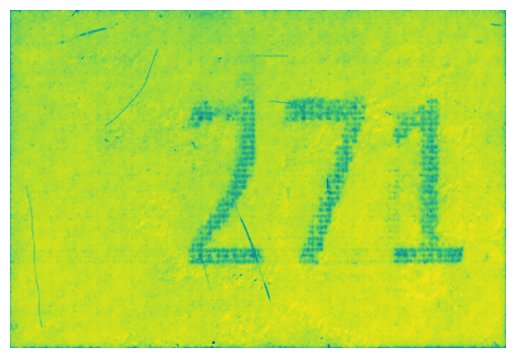

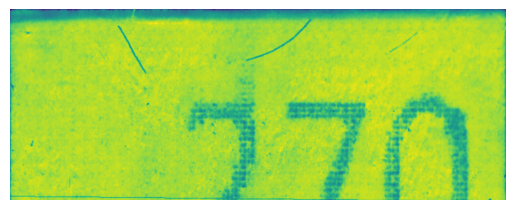

Contour area: 771403.5
Contour area: 339527.0
Contour area: 298286.5
Contour area: 30721.5
Contour area: 11633.5
Contour area: 11418.0
Contour area: 11201.0
Contour area: 8974.0
Contour area: 8515.5
Contour area: 8438.0
Contour area: 8413.0
Contour area: 7360.0
Contour area: 3500.0
Contour area: 1842.5
Contour area: 1133.0
Contour area: 1054.0
Contour area: 715.5
Contour area: 646.5
Contour area: 484.5
Contour area: 458.5
Contour area: 407.5
Contour area: 382.0
Contour area: 345.5
Contour area: 316.5
Contour area: 312.0
Contour area: 294.5
Contour area: 288.0
Contour area: 249.0
Contour area: 191.0
Contour area: 172.5
Contour area: 167.0
Contour area: 157.5
Contour area: 151.0
Contour area: 150.0
Contour area: 138.5
Contour area: 138.0
Contour area: 126.0
Contour area: 124.0
Contour area: 123.0
Contour area: 122.0
Contour area: 121.5
Contour area: 120.0
Contour area: 118.0
Contour area: 107.5
Contour area: 106.0
Contour area: 105.5
Contour area: 105.0
Contour area: 102.0
Contour area: 

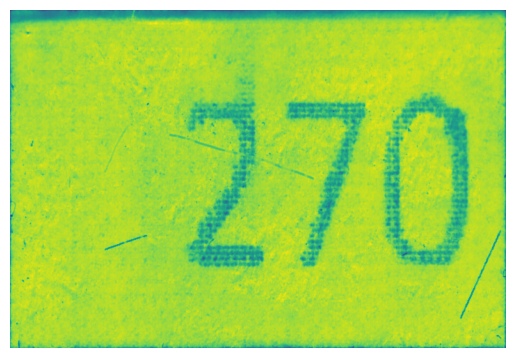

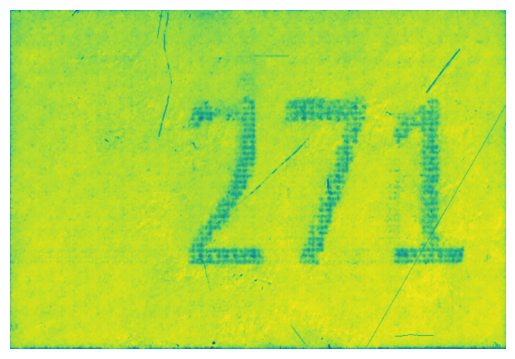

Contour area: 703925.5
Contour area: 457711.5
Contour area: 140010.5
Contour area: 18969.5
Contour area: 15139.0
Contour area: 4312.0
Contour area: 2065.5
Contour area: 1855.0
Contour area: 890.0
Contour area: 443.0
Contour area: 263.5
Contour area: 201.5
Contour area: 176.0
Contour area: 144.0
Contour area: 132.5
Contour area: 123.5
Contour area: 111.0
Contour area: 95.0
Contour area: 92.0
Contour area: 89.5
Contour area: 88.0
Contour area: 76.0
Contour area: 76.0
Contour area: 74.0
Contour area: 64.5
Contour area: 64.0
Contour area: 62.5
Contour area: 60.0
Contour area: 55.0
Contour area: 54.5
Contour area: 52.5
Contour area: 51.5
Contour area: 49.5
Contour area: 49.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 46.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.0
Contour area: 40.5
Contour area: 36.5
Contour area: 36.0
Contour area: 32.0
Contour area: 29.0
Contour area: 29.0
Contour area: 29.0
Contour area: 28.

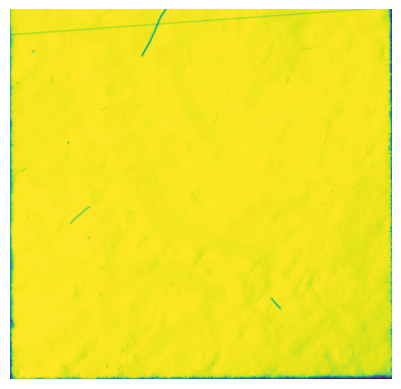

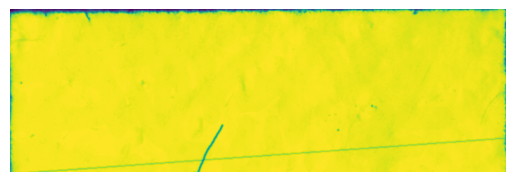

Contour area: 707354.5
Contour area: 582794.5
Contour area: 18522.0
Contour area: 16366.5
Contour area: 14726.0
Contour area: 3634.0
Contour area: 2001.0
Contour area: 1705.0
Contour area: 1087.0
Contour area: 438.0
Contour area: 380.0
Contour area: 365.5
Contour area: 199.0
Contour area: 175.0
Contour area: 164.0
Contour area: 148.5
Contour area: 144.0
Contour area: 132.5
Contour area: 99.0
Contour area: 99.0
Contour area: 98.0
Contour area: 91.0
Contour area: 88.0
Contour area: 82.5
Contour area: 77.0
Contour area: 76.0
Contour area: 67.0
Contour area: 63.5
Contour area: 60.0
Contour area: 56.5
Contour area: 53.5
Contour area: 52.5
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 50.5
Contour area: 48.0
Contour area: 48.0
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 45.0
Contour area: 43.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.0
Contour area: 40.5
Contour area: 40.5
Contour area: 40

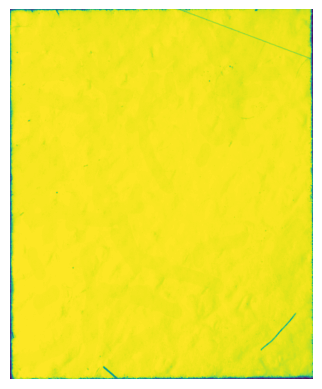

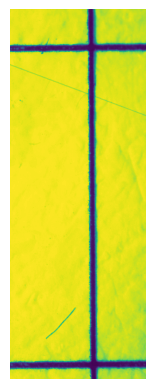

Contour area: 923768.5
Contour area: 332428.5
Contour area: 325422.0
Contour area: 60582.0
Contour area: 59149.5
Contour area: 32612.5
Contour area: 18864.0
Contour area: 11882.0
Contour area: 11877.0
Contour area: 11134.0
Contour area: 11112.5
Contour area: 10519.0
Contour area: 6203.0
Contour area: 3171.5
Contour area: 1494.5
Contour area: 1364.5
Contour area: 1350.5
Contour area: 848.0
Contour area: 722.0
Contour area: 536.5
Contour area: 449.0
Contour area: 412.0
Contour area: 367.5
Contour area: 317.0
Contour area: 272.0
Contour area: 266.0
Contour area: 233.0
Contour area: 230.5
Contour area: 228.0
Contour area: 224.5
Contour area: 210.0
Contour area: 199.5
Contour area: 191.5
Contour area: 190.0
Contour area: 181.0
Contour area: 180.5
Contour area: 169.0
Contour area: 162.5
Contour area: 158.5
Contour area: 157.5
Contour area: 150.0
Contour area: 141.0
Contour area: 139.5
Contour area: 139.0
Contour area: 137.5
Contour area: 131.5
Contour area: 129.5
Contour area: 129.0
Contour 

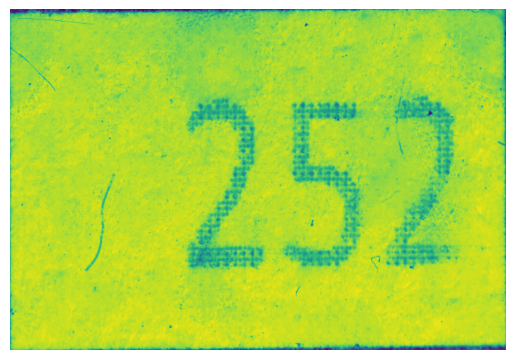

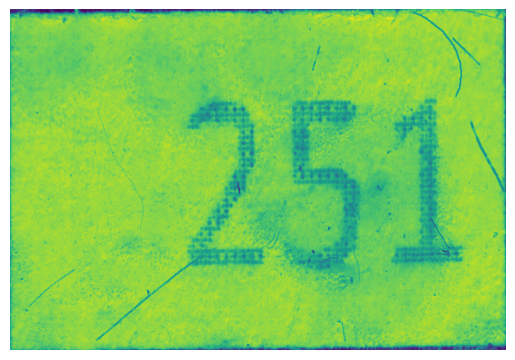

Contour area: 713336.0
Contour area: 567668.5
Contour area: 28188.5
Contour area: 17898.0
Contour area: 9909.0
Contour area: 2749.0
Contour area: 1852.5
Contour area: 1755.5
Contour area: 1340.5
Contour area: 1031.5
Contour area: 779.0
Contour area: 769.0
Contour area: 727.5
Contour area: 723.5
Contour area: 640.0
Contour area: 555.0
Contour area: 491.5
Contour area: 465.0
Contour area: 406.0
Contour area: 363.0
Contour area: 344.0
Contour area: 315.0
Contour area: 293.0
Contour area: 292.0
Contour area: 257.0
Contour area: 244.0
Contour area: 239.5
Contour area: 223.0
Contour area: 197.5
Contour area: 188.5
Contour area: 179.5
Contour area: 164.0
Contour area: 163.5
Contour area: 160.0
Contour area: 139.5
Contour area: 116.0
Contour area: 114.0
Contour area: 112.0
Contour area: 101.0
Contour area: 100.5
Contour area: 96.0
Contour area: 95.0
Contour area: 94.5
Contour area: 82.5
Contour area: 75.0
Contour area: 73.0
Contour area: 65.5
Contour area: 64.0
Contour area: 59.0
Contour area:

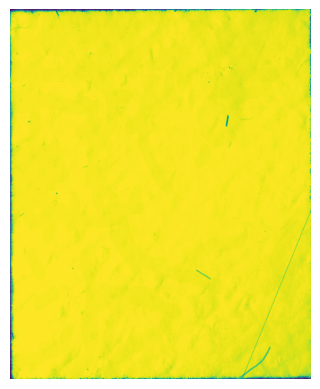

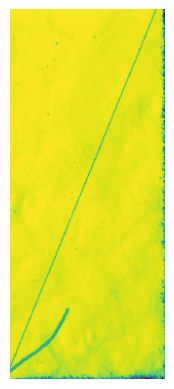

Contour area: 752368.5
Contour area: 343680.0
Contour area: 340785.0
Contour area: 4969.5
Contour area: 4229.5
Contour area: 2887.0
Contour area: 2246.5
Contour area: 2233.5
Contour area: 1948.5
Contour area: 1721.5
Contour area: 1519.0
Contour area: 1510.0
Contour area: 1212.0
Contour area: 1167.5
Contour area: 895.0
Contour area: 839.5
Contour area: 802.5
Contour area: 773.0
Contour area: 773.0
Contour area: 755.0
Contour area: 751.0
Contour area: 669.0
Contour area: 601.5
Contour area: 590.0
Contour area: 526.5
Contour area: 490.5
Contour area: 433.5
Contour area: 423.0
Contour area: 423.0
Contour area: 388.5
Contour area: 364.5
Contour area: 348.0
Contour area: 344.5
Contour area: 331.0
Contour area: 315.5
Contour area: 315.0
Contour area: 274.5
Contour area: 260.0
Contour area: 237.0
Contour area: 236.5
Contour area: 229.5
Contour area: 229.5
Contour area: 209.5
Contour area: 208.0
Contour area: 207.0
Contour area: 203.0
Contour area: 199.0
Contour area: 197.5
Contour area: 193.5


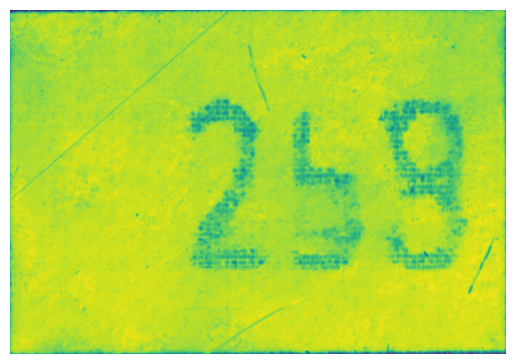

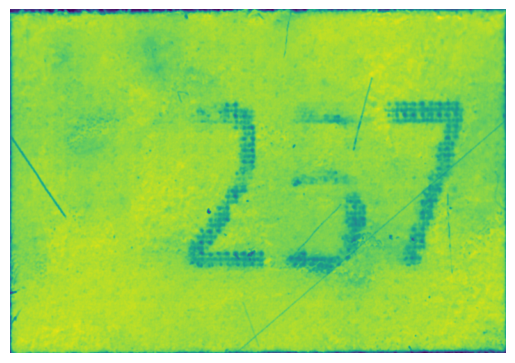

Contour area: 695939.5
Contour area: 581270.0
Contour area: 59319.0
Contour area: 19282.5
Contour area: 8692.5
Contour area: 4987.5
Contour area: 2547.5
Contour area: 1812.0
Contour area: 1403.5
Contour area: 1065.0
Contour area: 886.0
Contour area: 493.0
Contour area: 311.0
Contour area: 188.5
Contour area: 127.0
Contour area: 121.0
Contour area: 105.0
Contour area: 90.5
Contour area: 83.5
Contour area: 76.0
Contour area: 75.0
Contour area: 73.5
Contour area: 66.5
Contour area: 60.5
Contour area: 58.5
Contour area: 58.5
Contour area: 55.0
Contour area: 53.5
Contour area: 53.5
Contour area: 49.5
Contour area: 48.5
Contour area: 48.5
Contour area: 47.5
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 45.5
Contour area: 45.0
Contour area: 43.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 37.0
Contour area: 36.0
Contour area: 34.5
Contour area: 31.0
Contour area: 28.5
Contour area: 28.5
Contour area: 24.5
Contour area: 24.0
Contour area: 24.

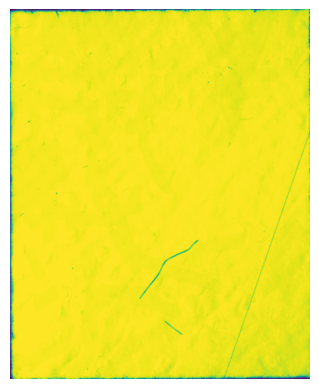

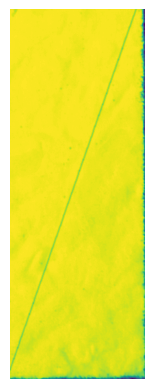

Contour area: 756585.0
Contour area: 342962.5
Contour area: 234297.5
Contour area: 96802.0
Contour area: 6373.0
Contour area: 5854.0
Contour area: 5801.0
Contour area: 5268.0
Contour area: 4813.0
Contour area: 3267.0
Contour area: 2913.5
Contour area: 2880.5
Contour area: 2460.0
Contour area: 2200.0
Contour area: 1803.0
Contour area: 1154.5
Contour area: 1144.0
Contour area: 1080.5
Contour area: 1056.5
Contour area: 474.5
Contour area: 395.0
Contour area: 353.0
Contour area: 290.5
Contour area: 252.5
Contour area: 231.0
Contour area: 220.5
Contour area: 217.0
Contour area: 204.0
Contour area: 201.5
Contour area: 196.5
Contour area: 189.5
Contour area: 178.5
Contour area: 176.5
Contour area: 170.5
Contour area: 163.0
Contour area: 153.0
Contour area: 140.0
Contour area: 138.0
Contour area: 136.0
Contour area: 131.5
Contour area: 129.0
Contour area: 125.0
Contour area: 121.5
Contour area: 117.0
Contour area: 113.0
Contour area: 111.0
Contour area: 109.5
Contour area: 99.5
Contour area: 9

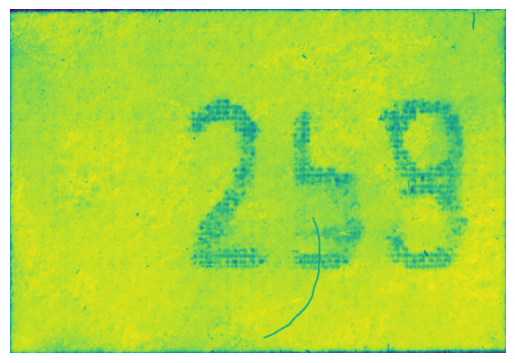

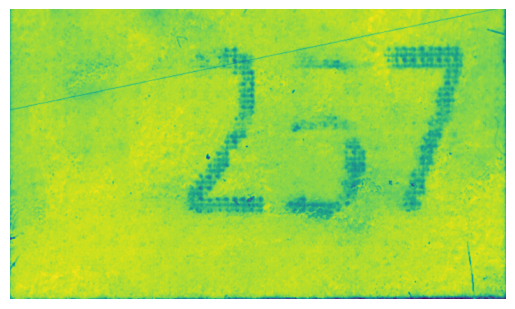

Contour area: 711170.5
Contour area: 385482.5
Contour area: 259589.5
Contour area: 11281.0
Contour area: 1728.5
Contour area: 1233.0
Contour area: 1185.5
Contour area: 1137.5
Contour area: 1059.5
Contour area: 903.5
Contour area: 864.0
Contour area: 808.5
Contour area: 808.5
Contour area: 754.0
Contour area: 607.5
Contour area: 514.5
Contour area: 474.0
Contour area: 430.0
Contour area: 342.5
Contour area: 326.0
Contour area: 272.5
Contour area: 235.5
Contour area: 235.0
Contour area: 142.0
Contour area: 131.0
Contour area: 128.5
Contour area: 127.5
Contour area: 120.0
Contour area: 109.0
Contour area: 60.0
Contour area: 60.0
Contour area: 58.0
Contour area: 53.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 39.5
Contour area: 36.0
Contour area: 36.0
Contour area: 34.5
Contour area: 30.0
Contour area: 30.0
Contour area: 29.0
Contour area: 29.0
Contour area: 28.5
Contour area: 24.0
Contour area: 24.0
Contour area: 24.0
Contour area: 22.0
Contour area: 20.0
Conto

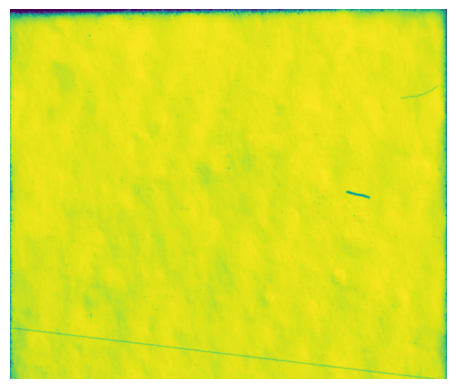

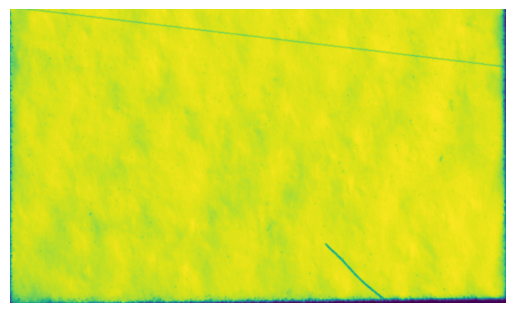

Contour area: 729643.5
Contour area: 381752.5
Contour area: 242621.0
Contour area: 2120.5
Contour area: 2059.5
Contour area: 1901.0
Contour area: 1488.0
Contour area: 1447.0
Contour area: 1403.0
Contour area: 1281.0
Contour area: 1245.5
Contour area: 1228.0
Contour area: 1138.5
Contour area: 742.0
Contour area: 644.5
Contour area: 615.5
Contour area: 543.0
Contour area: 529.0
Contour area: 445.5
Contour area: 376.0
Contour area: 325.5
Contour area: 318.0
Contour area: 314.5
Contour area: 289.0
Contour area: 231.0
Contour area: 198.0
Contour area: 192.0
Contour area: 176.5
Contour area: 143.0
Contour area: 115.5
Contour area: 111.0
Contour area: 99.0
Contour area: 94.5
Contour area: 92.0
Contour area: 87.5
Contour area: 85.5
Contour area: 75.5
Contour area: 74.5
Contour area: 71.0
Contour area: 64.0
Contour area: 58.0
Contour area: 57.5
Contour area: 57.0
Contour area: 57.0
Contour area: 54.0
Contour area: 52.5
Contour area: 52.0
Contour area: 48.0
Contour area: 47.0
Contour area: 46.5


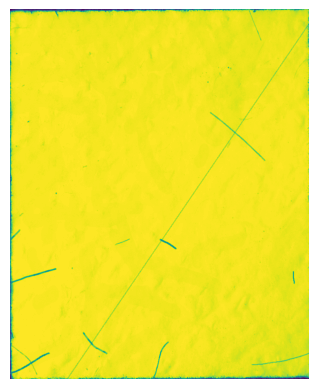

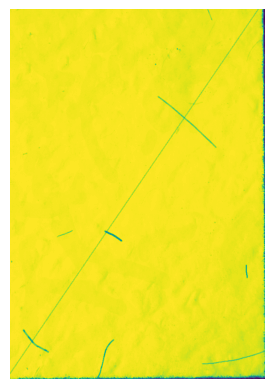

Contour area: 704914.5
Contour area: 591650.5
Contour area: 19649.5
Contour area: 15230.0
Contour area: 8655.0
Contour area: 4363.0
Contour area: 1874.5
Contour area: 1697.0
Contour area: 1610.5
Contour area: 1475.0
Contour area: 1438.0
Contour area: 1382.0
Contour area: 1153.5
Contour area: 978.5
Contour area: 972.0
Contour area: 923.5
Contour area: 371.0
Contour area: 347.0
Contour area: 326.0
Contour area: 206.0
Contour area: 162.0
Contour area: 157.0
Contour area: 141.0
Contour area: 123.5
Contour area: 120.5
Contour area: 111.0
Contour area: 92.5
Contour area: 89.5
Contour area: 86.0
Contour area: 84.5
Contour area: 82.5
Contour area: 74.0
Contour area: 73.0
Contour area: 62.5
Contour area: 61.0
Contour area: 60.0
Contour area: 55.0
Contour area: 55.0
Contour area: 54.5
Contour area: 52.0
Contour area: 51.5
Contour area: 49.5
Contour area: 48.0
Contour area: 47.0
Contour area: 46.0
Contour area: 44.0
Contour area: 44.0
Contour area: 42.5
Contour area: 42.0
Contour area: 42.0
Conto

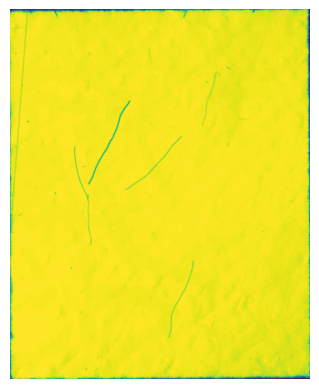

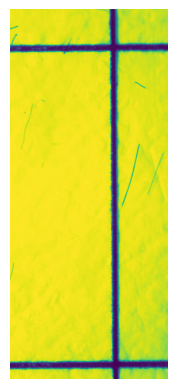

Contour area: 755326.0
Contour area: 251229.0
Contour area: 209347.0
Contour area: 119709.5
Contour area: 90957.5
Contour area: 7480.0
Contour area: 5274.0
Contour area: 5081.0
Contour area: 4043.0
Contour area: 3179.0
Contour area: 2470.0
Contour area: 2416.5
Contour area: 2251.0
Contour area: 2122.5
Contour area: 2115.0
Contour area: 2055.0
Contour area: 1821.0
Contour area: 1671.5
Contour area: 1648.0
Contour area: 1431.5
Contour area: 862.0
Contour area: 763.0
Contour area: 721.0
Contour area: 655.5
Contour area: 636.0
Contour area: 615.5
Contour area: 606.5
Contour area: 580.0
Contour area: 534.0
Contour area: 504.5
Contour area: 479.5
Contour area: 443.5
Contour area: 442.5
Contour area: 435.0
Contour area: 371.5
Contour area: 349.5
Contour area: 313.5
Contour area: 310.0
Contour area: 304.5
Contour area: 266.0
Contour area: 246.0
Contour area: 242.5
Contour area: 230.5
Contour area: 223.5
Contour area: 212.0
Contour area: 211.5
Contour area: 211.0
Contour area: 188.0
Contour are

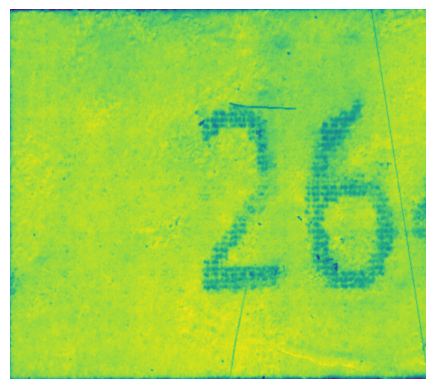

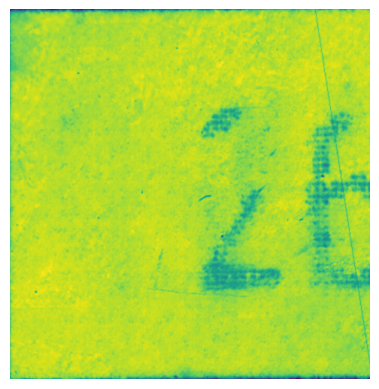

Contour area: 827199.0
Contour area: 599015.5
Contour area: 114628.5
Contour area: 14185.0
Contour area: 12480.5
Contour area: 3543.5
Contour area: 3004.0
Contour area: 2238.5
Contour area: 1890.5
Contour area: 1873.5
Contour area: 1536.5
Contour area: 1191.0
Contour area: 1186.5
Contour area: 1144.0
Contour area: 993.5
Contour area: 924.0
Contour area: 660.0
Contour area: 618.5
Contour area: 577.0
Contour area: 418.5
Contour area: 373.5
Contour area: 276.5
Contour area: 238.0
Contour area: 207.0
Contour area: 173.0
Contour area: 162.0
Contour area: 123.5
Contour area: 120.5
Contour area: 111.0
Contour area: 96.0
Contour area: 92.5
Contour area: 89.5
Contour area: 86.5
Contour area: 84.5
Contour area: 75.0
Contour area: 74.0
Contour area: 73.0
Contour area: 56.0
Contour area: 56.0
Contour area: 55.5
Contour area: 55.0
Contour area: 53.5
Contour area: 52.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 43.5
Contour area: 42.0

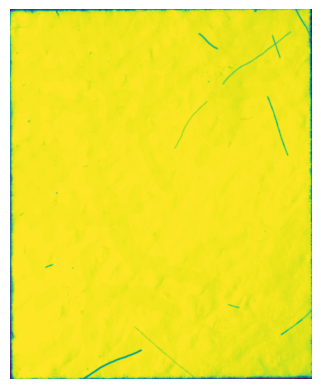

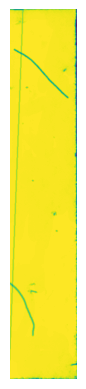

Contour area: 715697.0
Contour area: 552005.0
Contour area: 43525.0
Contour area: 18876.5
Contour area: 10894.5
Contour area: 5722.5
Contour area: 4219.5
Contour area: 3702.5
Contour area: 2112.5
Contour area: 1829.0
Contour area: 1468.5
Contour area: 1363.5
Contour area: 1127.0
Contour area: 877.0
Contour area: 664.5
Contour area: 620.0
Contour area: 517.5
Contour area: 516.5
Contour area: 424.0
Contour area: 281.0
Contour area: 210.0
Contour area: 183.0
Contour area: 142.0
Contour area: 134.5
Contour area: 132.5
Contour area: 112.5
Contour area: 110.0
Contour area: 94.5
Contour area: 92.0
Contour area: 85.5
Contour area: 78.5
Contour area: 78.0
Contour area: 75.0
Contour area: 74.0
Contour area: 68.0
Contour area: 65.0
Contour area: 62.5
Contour area: 60.0
Contour area: 54.5
Contour area: 53.5
Contour area: 52.5
Contour area: 49.5
Contour area: 49.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 43.0
Contour area: 42.0
Con

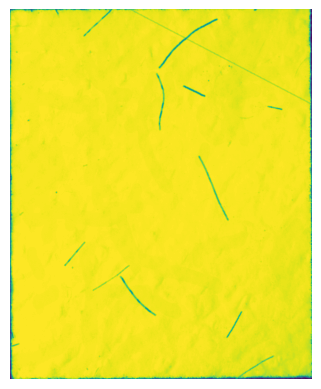

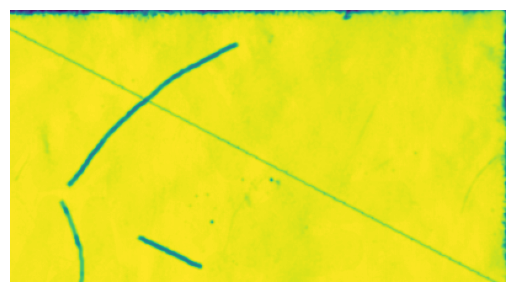

Contour area: 765562.5
Contour area: 323164.5
Contour area: 252229.5
Contour area: 85500.0
Contour area: 12116.5
Contour area: 9416.0
Contour area: 9044.5
Contour area: 8552.0
Contour area: 8540.5
Contour area: 7980.0
Contour area: 7582.5
Contour area: 5988.0
Contour area: 5509.5
Contour area: 2011.0
Contour area: 1520.0
Contour area: 1141.0
Contour area: 1130.0
Contour area: 631.5
Contour area: 447.5
Contour area: 347.0
Contour area: 307.5
Contour area: 283.5
Contour area: 265.5
Contour area: 239.5
Contour area: 217.0
Contour area: 188.0
Contour area: 176.5
Contour area: 157.5
Contour area: 150.0
Contour area: 143.5
Contour area: 138.0
Contour area: 127.5
Contour area: 126.0
Contour area: 122.0
Contour area: 122.0
Contour area: 121.5
Contour area: 115.0
Contour area: 108.5
Contour area: 106.0
Contour area: 104.5
Contour area: 99.5
Contour area: 98.5
Contour area: 98.5
Contour area: 97.0
Contour area: 94.5
Contour area: 92.0
Contour area: 91.0
Contour area: 86.5
Contour area: 85.5
Cont

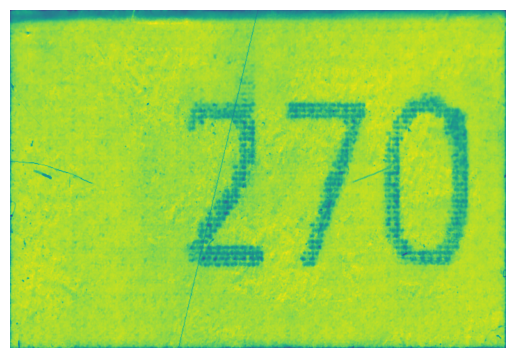

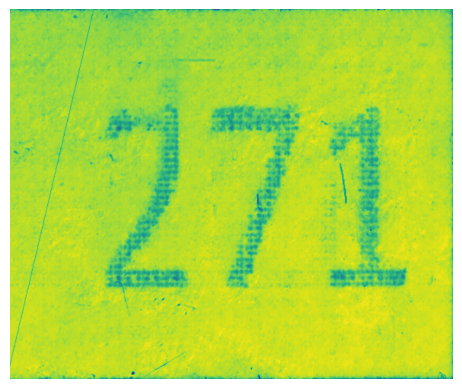

Contour area: 711525.0
Contour area: 489276.0
Contour area: 146820.5
Contour area: 4515.5
Contour area: 2792.5
Contour area: 2185.0
Contour area: 1804.0
Contour area: 1774.0
Contour area: 1716.5
Contour area: 1715.5
Contour area: 1148.0
Contour area: 833.5
Contour area: 782.5
Contour area: 604.5
Contour area: 562.5
Contour area: 481.5
Contour area: 349.5
Contour area: 335.5
Contour area: 189.0
Contour area: 139.0
Contour area: 133.0
Contour area: 105.5
Contour area: 103.5
Contour area: 100.0
Contour area: 98.0
Contour area: 87.5
Contour area: 85.5
Contour area: 81.0
Contour area: 70.0
Contour area: 67.5
Contour area: 55.0
Contour area: 53.5
Contour area: 53.5
Contour area: 52.5
Contour area: 52.5
Contour area: 51.5
Contour area: 51.5
Contour area: 49.5
Contour area: 48.5
Contour area: 47.0
Contour area: 47.0
Contour area: 46.0
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 40.5
Contour a

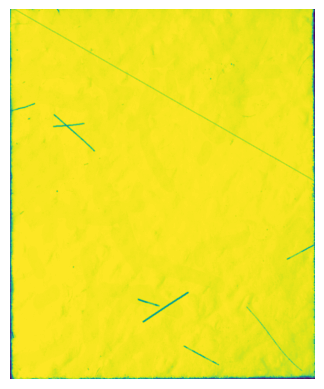

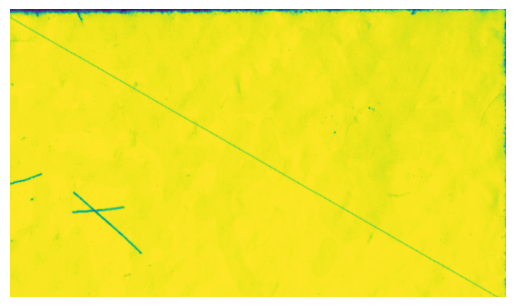

Contour area: 871254.0
Contour area: 337078.5
Contour area: 329101.5
Contour area: 62929.0
Contour area: 62116.0
Contour area: 8343.5
Contour area: 8274.0
Contour area: 5739.5
Contour area: 3185.0
Contour area: 3007.5
Contour area: 2173.0
Contour area: 1759.0
Contour area: 1756.5
Contour area: 1470.0
Contour area: 1466.0
Contour area: 1185.5
Contour area: 944.5
Contour area: 877.5
Contour area: 644.5
Contour area: 597.5
Contour area: 582.0
Contour area: 552.5
Contour area: 523.5
Contour area: 420.0
Contour area: 389.5
Contour area: 324.5
Contour area: 318.5
Contour area: 293.0
Contour area: 291.5
Contour area: 291.5
Contour area: 286.5
Contour area: 284.5
Contour area: 280.0
Contour area: 276.0
Contour area: 270.5
Contour area: 268.5
Contour area: 239.5
Contour area: 227.5
Contour area: 224.5
Contour area: 217.0
Contour area: 205.5
Contour area: 202.0
Contour area: 197.0
Contour area: 194.0
Contour area: 183.5
Contour area: 182.0
Contour area: 175.0
Contour area: 174.0
Contour area: 17

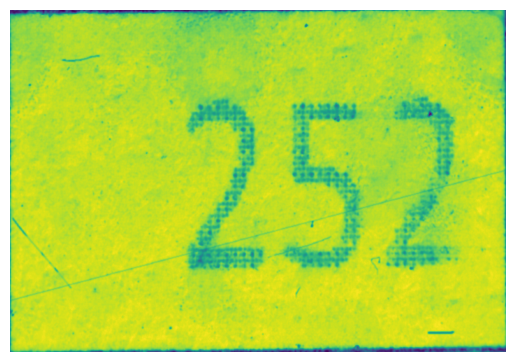

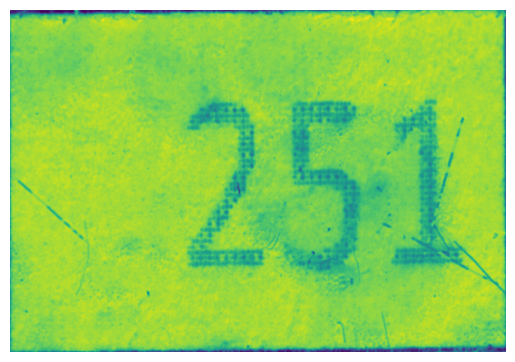

Contour area: 709330.0
Contour area: 381672.0
Contour area: 211942.5
Contour area: 11096.0
Contour area: 10609.5
Contour area: 7941.5
Contour area: 4449.0
Contour area: 2975.5
Contour area: 2741.5
Contour area: 2072.0
Contour area: 1889.5
Contour area: 1827.5
Contour area: 1354.0
Contour area: 1080.0
Contour area: 922.5
Contour area: 714.5
Contour area: 564.5
Contour area: 557.5
Contour area: 402.0
Contour area: 356.0
Contour area: 207.0
Contour area: 162.0
Contour area: 123.5
Contour area: 120.5
Contour area: 113.0
Contour area: 111.0
Contour area: 96.0
Contour area: 92.5
Contour area: 89.5
Contour area: 87.5
Contour area: 84.5
Contour area: 75.0
Contour area: 74.0
Contour area: 73.0
Contour area: 56.0
Contour area: 56.0
Contour area: 55.5
Contour area: 55.0
Contour area: 53.5
Contour area: 52.0
Contour area: 49.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 44.0
Contour area: 43.5
Contour area: 42.0
Contour area: 42.0
Co

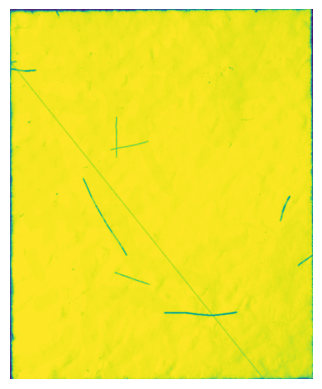

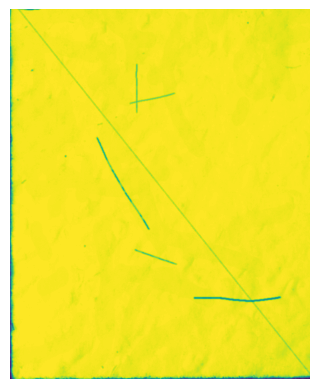

Contour area: 722514.5
Contour area: 481859.5
Contour area: 170213.5
Contour area: 11555.0
Contour area: 1574.5
Contour area: 1529.0
Contour area: 1431.5
Contour area: 1357.0
Contour area: 1352.5
Contour area: 1313.0
Contour area: 1300.0
Contour area: 1222.5
Contour area: 1137.0
Contour area: 840.5
Contour area: 671.0
Contour area: 665.0
Contour area: 575.0
Contour area: 557.0
Contour area: 501.0
Contour area: 347.0
Contour area: 288.0
Contour area: 265.5
Contour area: 245.0
Contour area: 234.5
Contour area: 171.0
Contour area: 138.0
Contour area: 125.5
Contour area: 114.5
Contour area: 101.5
Contour area: 93.5
Contour area: 87.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 69.0
Contour area: 69.0
Contour area: 66.5
Contour area: 61.0
Contour area: 58.5
Contour area: 57.0
Contour area: 52.5
Contour area: 50.5
Contour area: 47.0
Contour area: 45.5
Contour area: 44.0
Contour area: 44.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
C

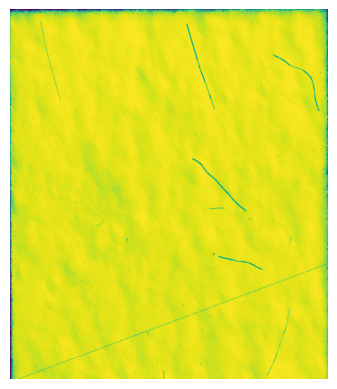

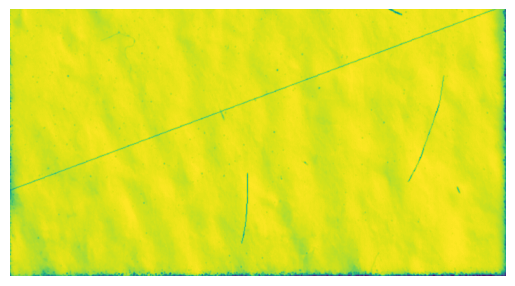

Contour area: 839893.5
Contour area: 341713.0
Contour area: 340542.0
Contour area: 67962.5
Contour area: 11941.5
Contour area: 8538.0
Contour area: 6808.5
Contour area: 6576.5
Contour area: 5444.5
Contour area: 4637.0
Contour area: 3057.0
Contour area: 2676.0
Contour area: 2370.0
Contour area: 2367.5
Contour area: 1749.0
Contour area: 1376.0
Contour area: 1328.5
Contour area: 1088.5
Contour area: 1050.5
Contour area: 1019.0
Contour area: 796.0
Contour area: 785.5
Contour area: 745.0
Contour area: 669.5
Contour area: 663.5
Contour area: 600.5
Contour area: 511.5
Contour area: 510.0
Contour area: 463.5
Contour area: 444.0
Contour area: 429.0
Contour area: 426.0
Contour area: 419.5
Contour area: 394.5
Contour area: 375.5
Contour area: 371.5
Contour area: 308.5
Contour area: 291.0
Contour area: 283.0
Contour area: 277.0
Contour area: 270.5
Contour area: 267.5
Contour area: 265.5
Contour area: 235.5
Contour area: 215.0
Contour area: 215.0
Contour area: 205.5
Contour area: 193.5
Contour area

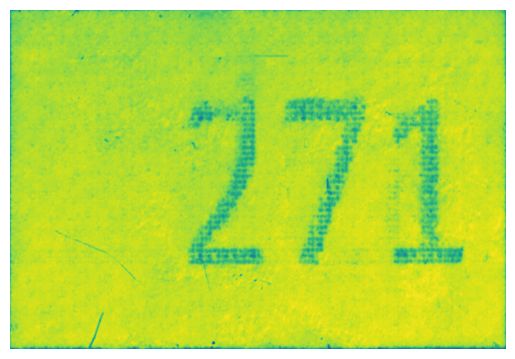

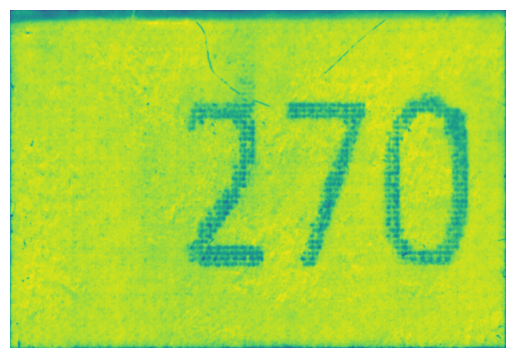

Contour area: 698275.5
Contour area: 616367.0
Contour area: 25830.5
Contour area: 10470.5
Contour area: 7336.5
Contour area: 2055.0
Contour area: 1756.0
Contour area: 1021.0
Contour area: 927.0
Contour area: 903.5
Contour area: 189.5
Contour area: 127.0
Contour area: 104.0
Contour area: 90.0
Contour area: 83.5
Contour area: 76.0
Contour area: 67.0
Contour area: 64.5
Contour area: 61.0
Contour area: 58.5
Contour area: 56.0
Contour area: 55.0
Contour area: 53.5
Contour area: 50.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.0
Contour area: 47.5
Contour area: 47.0
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 43.0
Contour area: 43.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 36.5
Contour area: 36.0
Contour area: 28.5
Contour area: 28.0
Contour area: 27.0
Contour area: 24.0
Contour area: 24.0
Contour area: 24.0
Contour area: 24.0
Contour area: 20.5
Contour area: 20.0
Contour area: 16.0
Cont

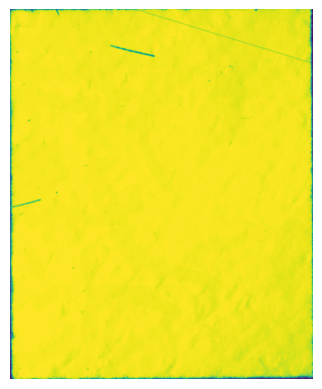

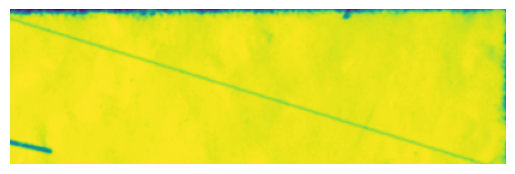

Contour area: 755806.5
Contour area: 323150.0
Contour area: 298710.0
Contour area: 42528.5
Contour area: 17914.5
Contour area: 11335.0
Contour area: 9403.5
Contour area: 6023.5
Contour area: 5112.0
Contour area: 4629.5
Contour area: 4530.0
Contour area: 4000.5
Contour area: 3555.0
Contour area: 2976.5
Contour area: 1925.0
Contour area: 1754.5
Contour area: 1499.0
Contour area: 1366.5
Contour area: 899.5
Contour area: 859.5
Contour area: 754.0
Contour area: 753.0
Contour area: 743.0
Contour area: 700.0
Contour area: 652.5
Contour area: 595.5
Contour area: 581.5
Contour area: 478.0
Contour area: 451.5
Contour area: 372.5
Contour area: 370.0
Contour area: 296.0
Contour area: 263.5
Contour area: 209.5
Contour area: 188.5
Contour area: 187.5
Contour area: 187.5
Contour area: 178.5
Contour area: 176.5
Contour area: 175.5
Contour area: 175.0
Contour area: 173.5
Contour area: 172.0
Contour area: 170.0
Contour area: 165.5
Contour area: 165.0
Contour area: 159.5
Contour area: 155.5
Contour area:

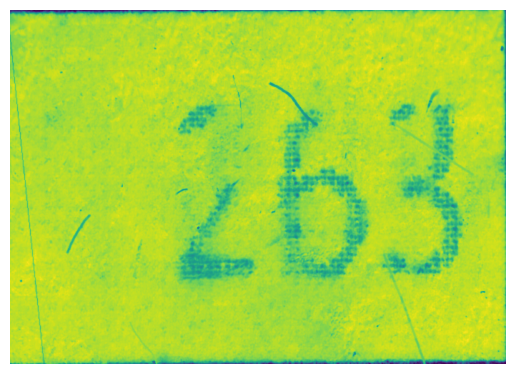

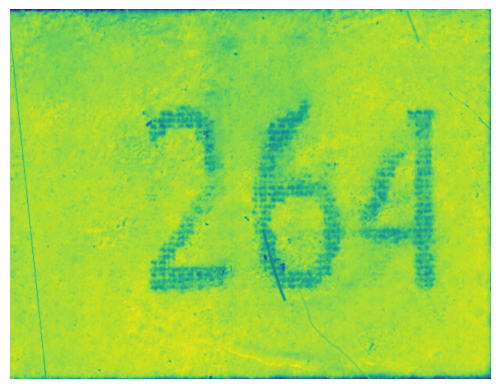

Contour area: 748143.0
Contour area: 642933.5
Contour area: 20851.5
Contour area: 5629.5
Contour area: 4446.5
Contour area: 3376.0
Contour area: 2678.0
Contour area: 2160.0
Contour area: 1778.0
Contour area: 1240.0
Contour area: 1150.5
Contour area: 911.5
Contour area: 853.5
Contour area: 607.0
Contour area: 463.0
Contour area: 458.5
Contour area: 346.5
Contour area: 334.5
Contour area: 204.5
Contour area: 189.0
Contour area: 133.0
Contour area: 104.5
Contour area: 103.5
Contour area: 97.0
Contour area: 90.5
Contour area: 87.5
Contour area: 81.0
Contour area: 78.0
Contour area: 70.0
Contour area: 67.5
Contour area: 56.0
Contour area: 55.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 52.0
Contour area: 51.5
Contour area: 51.5
Contour area: 49.5
Contour area: 48.5
Contour area: 47.0
Contour area: 45.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 40.5
Contour area: 40.5
Contour are

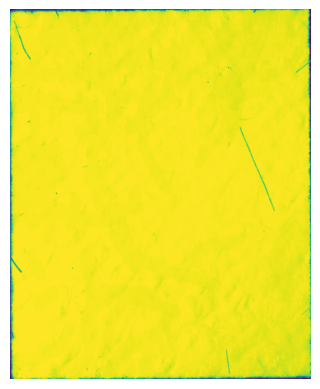

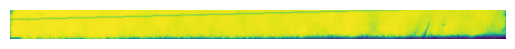

Contour area: 702874.5
Contour area: 536500.0
Contour area: 101156.5
Contour area: 9259.0
Contour area: 4713.5
Contour area: 2243.0
Contour area: 1663.5
Contour area: 1453.5
Contour area: 1072.5
Contour area: 490.5
Contour area: 481.0
Contour area: 442.0
Contour area: 402.0
Contour area: 189.0
Contour area: 185.5
Contour area: 127.0
Contour area: 121.0
Contour area: 105.0
Contour area: 93.0
Contour area: 90.5
Contour area: 86.5
Contour area: 82.5
Contour area: 76.0
Contour area: 67.5
Contour area: 63.0
Contour area: 58.5
Contour area: 57.5
Contour area: 55.0
Contour area: 54.0
Contour area: 53.5
Contour area: 52.5
Contour area: 49.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.0
Contour area: 47.5
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 45.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 36.0
Contour area: 36.0
Contour area: 32.5
Contour area: 32.5
Contour area: 29.0
Contour area: 29.

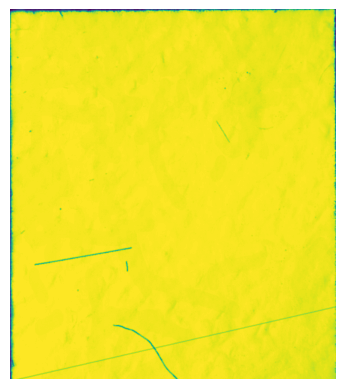

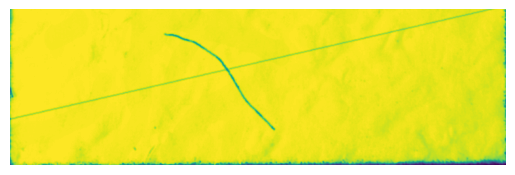

Contour area: 715095.5
Contour area: 637563.5
Contour area: 10449.0
Contour area: 6486.5
Contour area: 2510.0
Contour area: 2055.5
Contour area: 2007.0
Contour area: 1856.5
Contour area: 1692.5
Contour area: 1584.0
Contour area: 1473.5
Contour area: 1413.0
Contour area: 1394.5
Contour area: 1230.5
Contour area: 704.5
Contour area: 547.5
Contour area: 528.0
Contour area: 420.5
Contour area: 393.0
Contour area: 385.0
Contour area: 384.0
Contour area: 324.5
Contour area: 314.5
Contour area: 289.0
Contour area: 198.0
Contour area: 190.0
Contour area: 142.0
Contour area: 128.0
Contour area: 120.5
Contour area: 111.0
Contour area: 99.5
Contour area: 99.0
Contour area: 87.5
Contour area: 81.5
Contour area: 74.5
Contour area: 71.0
Contour area: 62.5
Contour area: 58.0
Contour area: 57.0
Contour area: 57.0
Contour area: 54.0
Contour area: 53.5
Contour area: 52.5
Contour area: 51.5
Contour area: 49.0
Contour area: 48.0
Contour area: 47.0
Contour area: 46.5
Contour area: 46.5
Contour area: 46.0
C

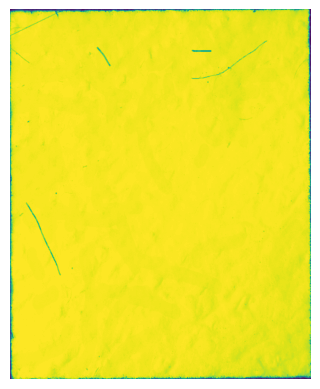

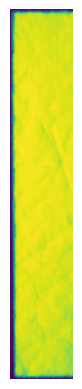

Contour area: 758118.5
Contour area: 236883.5
Contour area: 199306.5
Contour area: 130679.0
Contour area: 102477.5
Contour area: 19129.5
Contour area: 12860.0
Contour area: 8556.0
Contour area: 8203.5
Contour area: 7416.0
Contour area: 5762.0
Contour area: 5104.5
Contour area: 3962.5
Contour area: 1541.5
Contour area: 1096.5
Contour area: 1086.0
Contour area: 1066.5
Contour area: 1048.5
Contour area: 961.0
Contour area: 921.5
Contour area: 921.0
Contour area: 432.5
Contour area: 407.0
Contour area: 394.5
Contour area: 380.5
Contour area: 285.0
Contour area: 276.5
Contour area: 260.0
Contour area: 239.5
Contour area: 237.0
Contour area: 233.0
Contour area: 204.0
Contour area: 187.5
Contour area: 183.0
Contour area: 163.5
Contour area: 158.5
Contour area: 146.5
Contour area: 145.5
Contour area: 143.0
Contour area: 142.5
Contour area: 139.5
Contour area: 134.5
Contour area: 133.0
Contour area: 132.5
Contour area: 132.0
Contour area: 128.0
Contour area: 127.0
Contour area: 126.5
Contour ar

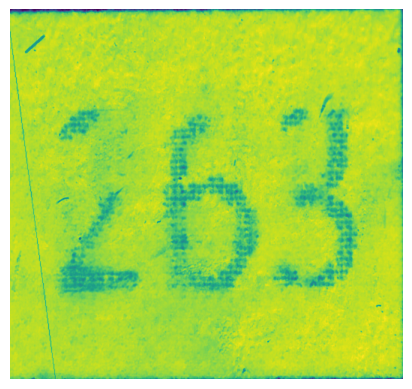

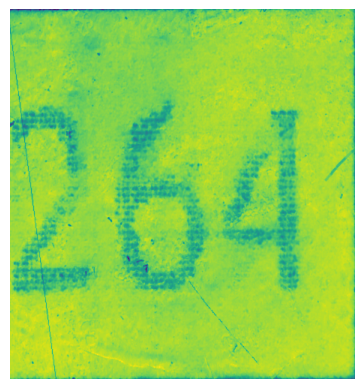

Contour area: 693062.0
Contour area: 409053.5
Contour area: 225258.0
Contour area: 13621.0
Contour area: 11086.0
Contour area: 2092.5
Contour area: 1733.0
Contour area: 1700.5
Contour area: 1568.5
Contour area: 1510.0
Contour area: 1391.5
Contour area: 1294.5
Contour area: 1101.0
Contour area: 1000.5
Contour area: 896.0
Contour area: 846.5
Contour area: 748.0
Contour area: 640.0
Contour area: 590.0
Contour area: 578.5
Contour area: 508.0
Contour area: 475.0
Contour area: 404.5
Contour area: 398.0
Contour area: 365.5
Contour area: 341.0
Contour area: 338.5
Contour area: 310.0
Contour area: 287.5
Contour area: 267.5
Contour area: 263.0
Contour area: 201.0
Contour area: 191.5
Contour area: 190.5
Contour area: 147.5
Contour area: 114.0
Contour area: 102.0
Contour area: 101.5
Contour area: 93.5
Contour area: 90.5
Contour area: 86.5
Contour area: 85.5
Contour area: 79.5
Contour area: 71.0
Contour area: 70.0
Contour area: 59.5
Contour area: 58.0
Contour area: 54.5
Contour area: 54.5
Contour a

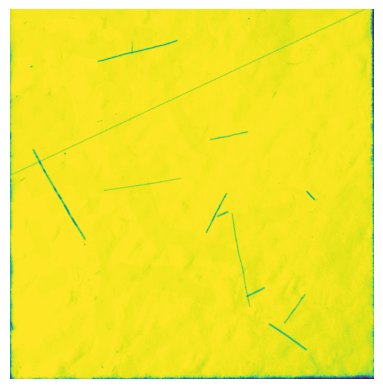

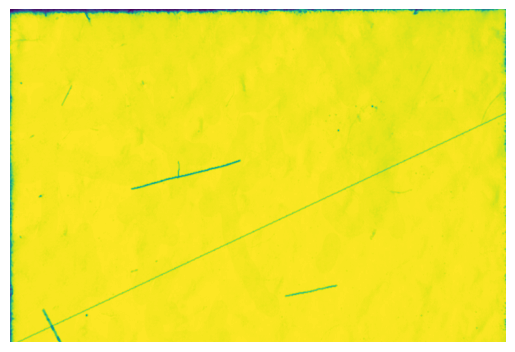

Contour area: 916992.0
Contour area: 334352.0
Contour area: 164373.0
Contour area: 136619.0
Contour area: 62780.5
Contour area: 47089.0
Contour area: 39741.0
Contour area: 20798.0
Contour area: 12969.0
Contour area: 11291.5
Contour area: 9738.5
Contour area: 2788.0
Contour area: 1193.5
Contour area: 606.0
Contour area: 544.0
Contour area: 539.0
Contour area: 402.5
Contour area: 378.5
Contour area: 314.0
Contour area: 309.5
Contour area: 303.5
Contour area: 302.0
Contour area: 300.0
Contour area: 273.5
Contour area: 256.0
Contour area: 229.0
Contour area: 213.5
Contour area: 208.0
Contour area: 202.5
Contour area: 197.0
Contour area: 189.5
Contour area: 186.5
Contour area: 185.0
Contour area: 175.5
Contour area: 174.0
Contour area: 173.5
Contour area: 169.0
Contour area: 163.0
Contour area: 143.5
Contour area: 139.0
Contour area: 138.0
Contour area: 135.0
Contour area: 126.5
Contour area: 120.0
Contour area: 119.5
Contour area: 117.5
Contour area: 115.0
Contour area: 109.0
Contour area:

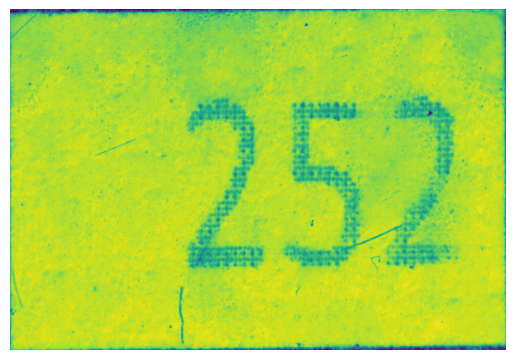

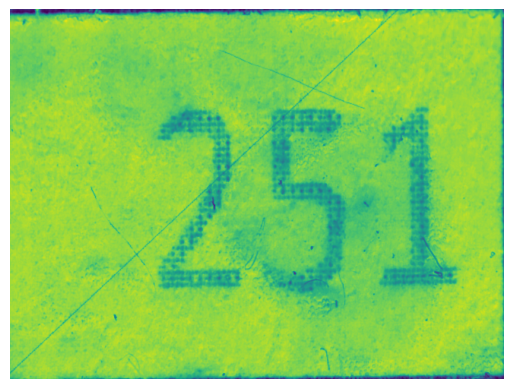

Contour area: 709502.0
Contour area: 450378.5
Contour area: 179106.0
Contour area: 10566.5
Contour area: 4340.5
Contour area: 3648.5
Contour area: 2157.5
Contour area: 1815.0
Contour area: 1511.5
Contour area: 1150.5
Contour area: 1097.5
Contour area: 717.0
Contour area: 666.5
Contour area: 619.0
Contour area: 606.0
Contour area: 528.5
Contour area: 498.0
Contour area: 476.0
Contour area: 377.5
Contour area: 348.0
Contour area: 337.0
Contour area: 331.5
Contour area: 202.5
Contour area: 189.0
Contour area: 139.0
Contour area: 133.0
Contour area: 105.0
Contour area: 103.5
Contour area: 97.0
Contour area: 90.5
Contour area: 87.5
Contour area: 81.0
Contour area: 70.0
Contour area: 67.5
Contour area: 56.0
Contour area: 55.0
Contour area: 53.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 52.0
Contour area: 51.5
Contour area: 50.5
Contour area: 48.5
Contour area: 48.5
Contour area: 45.0
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Cont

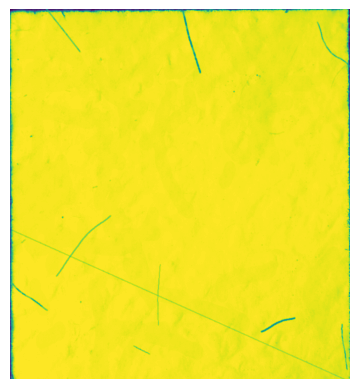

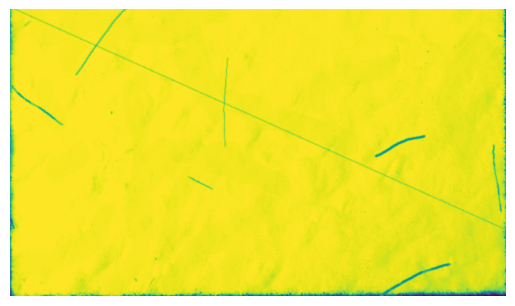

Contour area: 782911.0
Contour area: 342965.5
Contour area: 275972.0
Contour area: 63985.0
Contour area: 20257.0
Contour area: 9449.0
Contour area: 7804.5
Contour area: 5008.5
Contour area: 3999.0
Contour area: 3855.5
Contour area: 3389.0
Contour area: 2764.5
Contour area: 2450.5
Contour area: 2164.0
Contour area: 1917.0
Contour area: 1678.0
Contour area: 1649.5
Contour area: 1445.5
Contour area: 867.0
Contour area: 848.0
Contour area: 759.0
Contour area: 677.0
Contour area: 632.0
Contour area: 624.0
Contour area: 615.5
Contour area: 598.5
Contour area: 572.5
Contour area: 506.5
Contour area: 498.5
Contour area: 445.0
Contour area: 435.0
Contour area: 413.5
Contour area: 311.5
Contour area: 261.5
Contour area: 223.0
Contour area: 211.0
Contour area: 210.5
Contour area: 190.0
Contour area: 177.0
Contour area: 176.5
Contour area: 173.0
Contour area: 173.0
Contour area: 169.5
Contour area: 164.5
Contour area: 154.0
Contour area: 150.5
Contour area: 146.0
Contour area: 141.0
Contour area: 

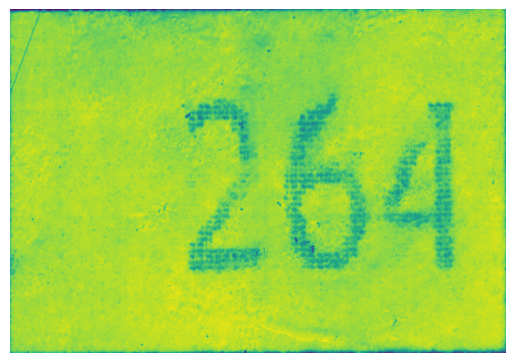

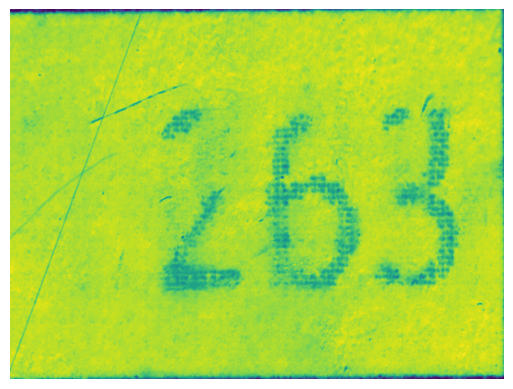

Contour area: 711432.0
Contour area: 559971.5
Contour area: 32355.0
Contour area: 13903.5
Contour area: 7605.0
Contour area: 5179.5
Contour area: 2838.5
Contour area: 1955.5
Contour area: 1826.0
Contour area: 1580.0
Contour area: 1516.0
Contour area: 1327.5
Contour area: 1221.0
Contour area: 1160.0
Contour area: 1069.0
Contour area: 845.5
Contour area: 811.0
Contour area: 686.0
Contour area: 540.0
Contour area: 511.0
Contour area: 489.0
Contour area: 481.5
Contour area: 458.0
Contour area: 406.0
Contour area: 403.0
Contour area: 374.0
Contour area: 263.0
Contour area: 218.0
Contour area: 217.0
Contour area: 215.5
Contour area: 194.5
Contour area: 180.5
Contour area: 180.0
Contour area: 144.0
Contour area: 141.5
Contour area: 132.5
Contour area: 110.5
Contour area: 102.0
Contour area: 97.5
Contour area: 96.0
Contour area: 96.0
Contour area: 94.5
Contour area: 93.0
Contour area: 86.0
Contour area: 78.5
Contour area: 72.0
Contour area: 62.5
Contour area: 58.5
Contour area: 56.5
Contour ar

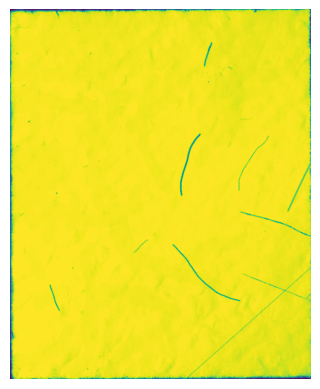

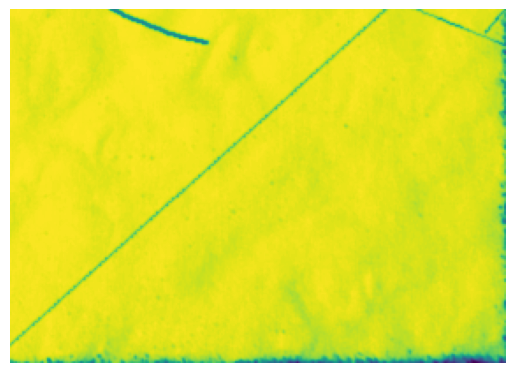

Contour area: 711379.5
Contour area: 538913.5
Contour area: 54881.0
Contour area: 17571.5
Contour area: 6537.0
Contour area: 3164.5
Contour area: 2651.0
Contour area: 1882.0
Contour area: 1745.5
Contour area: 1712.5
Contour area: 1480.0
Contour area: 1184.5
Contour area: 1043.0
Contour area: 991.5
Contour area: 980.0
Contour area: 796.5
Contour area: 678.5
Contour area: 597.5
Contour area: 553.5
Contour area: 453.5
Contour area: 412.5
Contour area: 377.5
Contour area: 377.0
Contour area: 352.0
Contour area: 328.5
Contour area: 309.5
Contour area: 288.0
Contour area: 287.5
Contour area: 222.5
Contour area: 188.5
Contour area: 183.0
Contour area: 168.0
Contour area: 163.5
Contour area: 161.5
Contour area: 146.0
Contour area: 127.0
Contour area: 118.0
Contour area: 108.0
Contour area: 94.5
Contour area: 93.0
Contour area: 92.0
Contour area: 84.0
Contour area: 81.5
Contour area: 76.0
Contour area: 76.0
Contour area: 72.0
Contour area: 65.5
Contour area: 64.5
Contour area: 64.0
Contour area

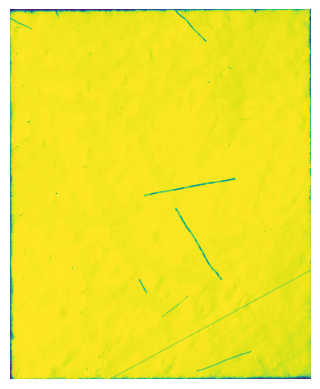

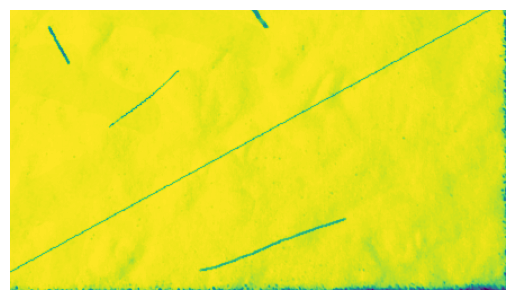

Contour area: 704538.5
Contour area: 500239.0
Contour area: 132135.5
Contour area: 10480.0
Contour area: 4395.5
Contour area: 2775.0
Contour area: 2134.5
Contour area: 1691.5
Contour area: 1599.0
Contour area: 1230.0
Contour area: 1167.5
Contour area: 1055.5
Contour area: 783.5
Contour area: 651.5
Contour area: 601.0
Contour area: 585.0
Contour area: 463.5
Contour area: 377.0
Contour area: 339.0
Contour area: 316.5
Contour area: 246.5
Contour area: 199.0
Contour area: 187.5
Contour area: 139.0
Contour area: 127.0
Contour area: 110.5
Contour area: 105.0
Contour area: 104.5
Contour area: 89.5
Contour area: 87.5
Contour area: 81.0
Contour area: 70.0
Contour area: 68.0
Contour area: 67.5
Contour area: 55.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 52.0
Contour area: 51.5
Contour area: 49.5
Contour area: 48.5
Contour area: 47.0
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Con

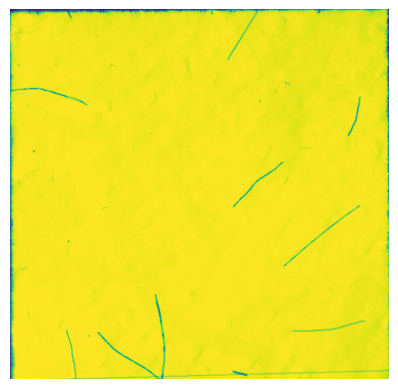

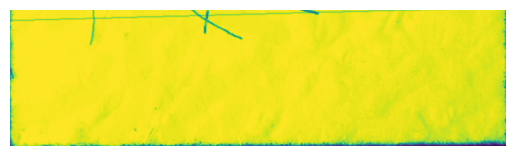

Contour area: 750300.0
Contour area: 222612.5
Contour area: 177081.5
Contour area: 158105.5
Contour area: 110682.0
Contour area: 5277.5
Contour area: 4407.5
Contour area: 2806.0
Contour area: 2289.5
Contour area: 2231.0
Contour area: 2132.5
Contour area: 1880.0
Contour area: 1511.5
Contour area: 1038.0
Contour area: 970.5
Contour area: 906.0
Contour area: 733.0
Contour area: 731.5
Contour area: 670.5
Contour area: 608.5
Contour area: 597.0
Contour area: 552.0
Contour area: 351.0
Contour area: 297.0
Contour area: 279.5
Contour area: 263.5
Contour area: 220.5
Contour area: 200.5
Contour area: 195.5
Contour area: 181.5
Contour area: 175.5
Contour area: 173.0
Contour area: 162.5
Contour area: 160.5
Contour area: 152.0
Contour area: 151.0
Contour area: 146.5
Contour area: 143.0
Contour area: 138.0
Contour area: 138.0
Contour area: 137.0
Contour area: 134.0
Contour area: 126.0
Contour area: 123.0
Contour area: 117.0
Contour area: 116.0
Contour area: 115.0
Contour area: 114.5
Contour area: 10

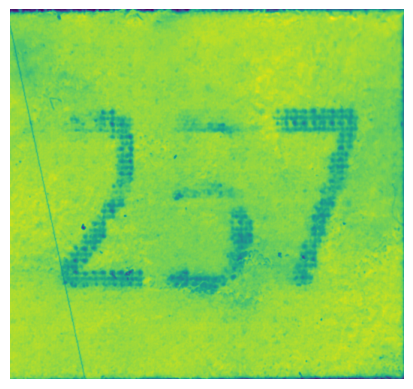

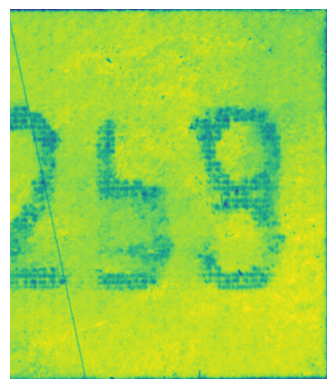

Contour area: 709155.5
Contour area: 327268.5
Contour area: 266153.0
Contour area: 12971.5
Contour area: 11914.0
Contour area: 6068.5
Contour area: 1909.0
Contour area: 1644.0
Contour area: 1432.5
Contour area: 1337.5
Contour area: 1333.5
Contour area: 1144.0
Contour area: 982.0
Contour area: 649.5
Contour area: 526.5
Contour area: 464.5
Contour area: 406.0
Contour area: 345.5
Contour area: 322.5
Contour area: 292.0
Contour area: 256.5
Contour area: 254.5
Contour area: 251.5
Contour area: 197.5
Contour area: 189.0
Contour area: 187.0
Contour area: 171.5
Contour area: 153.0
Contour area: 145.5
Contour area: 144.0
Contour area: 139.5
Contour area: 112.0
Contour area: 108.0
Contour area: 97.0
Contour area: 96.0
Contour area: 95.0
Contour area: 94.5
Contour area: 82.5
Contour area: 78.0
Contour area: 67.5
Contour area: 64.0
Contour area: 64.0
Contour area: 62.5
Contour area: 59.0
Contour area: 53.5
Contour area: 52.5
Contour area: 52.0
Contour area: 52.0
Contour area: 52.0
Contour area: 50

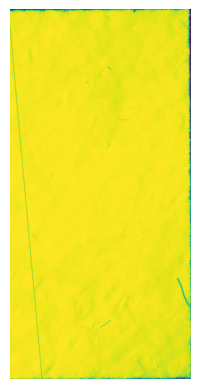

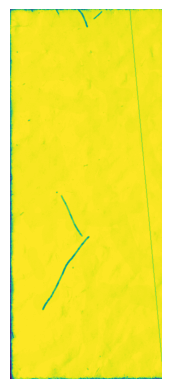

Contour area: 753789.5
Contour area: 343015.5
Contour area: 342048.0
Contour area: 5698.0
Contour area: 5133.5
Contour area: 3046.5
Contour area: 2986.5
Contour area: 2612.0
Contour area: 2118.5
Contour area: 1985.0
Contour area: 1858.0
Contour area: 1835.0
Contour area: 1686.0
Contour area: 1643.0
Contour area: 1615.5
Contour area: 1323.5
Contour area: 1259.5
Contour area: 886.5
Contour area: 885.5
Contour area: 858.0
Contour area: 653.5
Contour area: 609.0
Contour area: 595.0
Contour area: 541.5
Contour area: 520.0
Contour area: 508.5
Contour area: 474.0
Contour area: 450.5
Contour area: 357.0
Contour area: 354.0
Contour area: 323.5
Contour area: 322.0
Contour area: 277.0
Contour area: 275.5
Contour area: 238.0
Contour area: 235.5
Contour area: 234.5
Contour area: 222.5
Contour area: 220.0
Contour area: 215.0
Contour area: 197.5
Contour area: 185.0
Contour area: 184.5
Contour area: 184.0
Contour area: 178.0
Contour area: 177.0
Contour area: 174.5
Contour area: 155.0
Contour area: 152

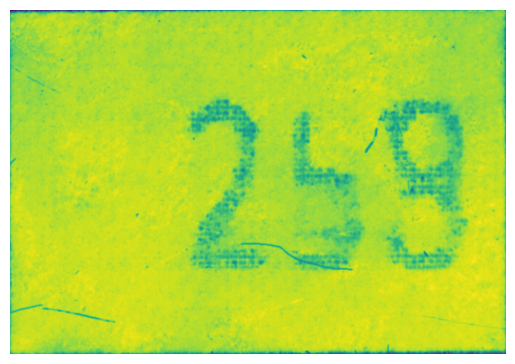

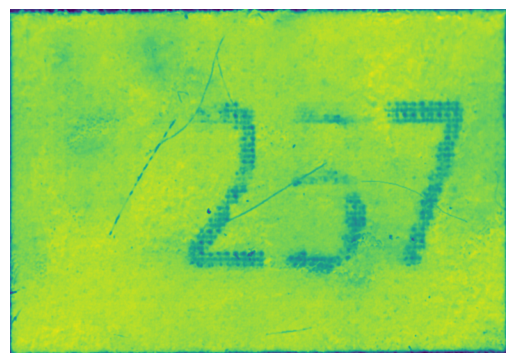

Contour area: 706875.5
Contour area: 475861.5
Contour area: 119911.5
Contour area: 10809.0
Contour area: 8819.0
Contour area: 7856.0
Contour area: 5952.5
Contour area: 4248.0
Contour area: 2027.0
Contour area: 1732.0
Contour area: 1545.5
Contour area: 796.5
Contour area: 511.5
Contour area: 448.0
Contour area: 382.0
Contour area: 197.5
Contour area: 181.0
Contour area: 140.0
Contour area: 132.5
Contour area: 110.0
Contour area: 96.5
Contour area: 92.0
Contour area: 88.0
Contour area: 84.5
Contour area: 82.5
Contour area: 78.5
Contour area: 72.0
Contour area: 71.0
Contour area: 63.5
Contour area: 59.5
Contour area: 55.0
Contour area: 54.5
Contour area: 54.5
Contour area: 52.5
Contour area: 50.5
Contour area: 48.5
Contour area: 48.0
Contour area: 48.0
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 45.0
Contour area: 44.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.5
Contour area: 41.5
Contour area: 40.5
Contour area: 37.5
Contour area

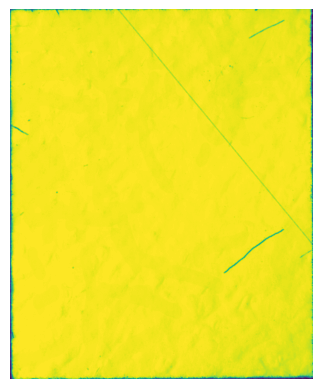

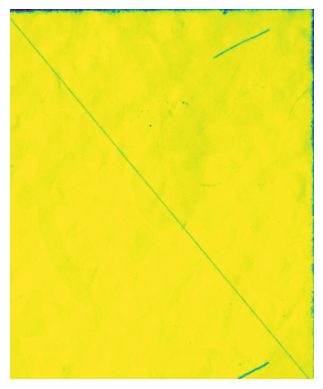

Contour area: 800874.0
Contour area: 654113.5
Contour area: 45563.5
Contour area: 6059.0
Contour area: 4662.5
Contour area: 1420.0
Contour area: 1345.0
Contour area: 1335.0
Contour area: 1264.0
Contour area: 1136.5
Contour area: 1102.5
Contour area: 851.0
Contour area: 840.0
Contour area: 738.0
Contour area: 730.0
Contour area: 660.5
Contour area: 640.5
Contour area: 563.5
Contour area: 503.5
Contour area: 361.5
Contour area: 285.5
Contour area: 235.5
Contour area: 185.5
Contour area: 158.0
Contour area: 129.5
Contour area: 127.5
Contour area: 123.0
Contour area: 101.5
Contour area: 97.5
Contour area: 93.5
Contour area: 87.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 75.0
Contour area: 71.0
Contour area: 70.0
Contour area: 69.0
Contour area: 66.0
Contour area: 64.0
Contour area: 58.5
Contour area: 54.0
Contour area: 52.5
Contour area: 50.5
Contour area: 50.0
Contour area: 47.0
Contour area: 44.0
Contour area: 44.0
Contour area: 43.0
Contour area: 42.0
Contou

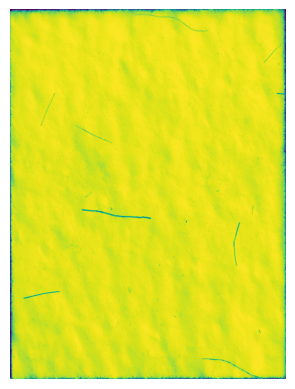

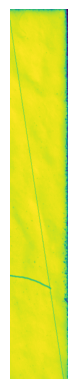

Contour area: 713782.5
Contour area: 610178.5
Contour area: 33766.5
Contour area: 13493.5
Contour area: 1373.0
Contour area: 1348.5
Contour area: 1054.5
Contour area: 1051.5
Contour area: 926.0
Contour area: 861.5
Contour area: 673.0
Contour area: 600.5
Contour area: 526.5
Contour area: 423.5
Contour area: 407.5
Contour area: 402.5
Contour area: 401.5
Contour area: 348.5
Contour area: 342.0
Contour area: 277.0
Contour area: 276.0
Contour area: 273.5
Contour area: 247.0
Contour area: 241.0
Contour area: 237.0
Contour area: 233.5
Contour area: 212.5
Contour area: 210.0
Contour area: 197.5
Contour area: 187.5
Contour area: 143.0
Contour area: 110.0
Contour area: 107.5
Contour area: 104.0
Contour area: 81.0
Contour area: 68.0
Contour area: 59.5
Contour area: 51.5
Contour area: 50.5
Contour area: 50.0
Contour area: 44.5
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 41.0
Contour area: 40.5
Contour area: 39.0
Co

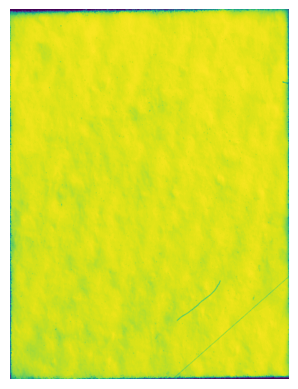

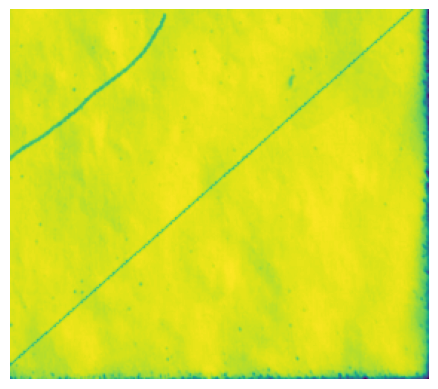

Contour area: 753684.0
Contour area: 343052.0
Contour area: 341346.0
Contour area: 5277.5
Contour area: 4749.5
Contour area: 4407.5
Contour area: 4022.5
Contour area: 3623.5
Contour area: 3125.5
Contour area: 2805.0
Contour area: 2757.5
Contour area: 1557.5
Contour area: 1426.5
Contour area: 1235.0
Contour area: 1107.5
Contour area: 969.0
Contour area: 906.0
Contour area: 733.0
Contour area: 731.5
Contour area: 670.5
Contour area: 608.5
Contour area: 597.0
Contour area: 547.0
Contour area: 484.0
Contour area: 372.5
Contour area: 352.5
Contour area: 351.0
Contour area: 330.0
Contour area: 310.0
Contour area: 297.0
Contour area: 284.0
Contour area: 279.5
Contour area: 263.5
Contour area: 219.5
Contour area: 219.5
Contour area: 207.5
Contour area: 204.5
Contour area: 200.5
Contour area: 190.0
Contour area: 190.0
Contour area: 181.5
Contour area: 175.5
Contour area: 174.5
Contour area: 173.0
Contour area: 162.5
Contour area: 160.5
Contour area: 156.5
Contour area: 152.0
Contour area: 151.0

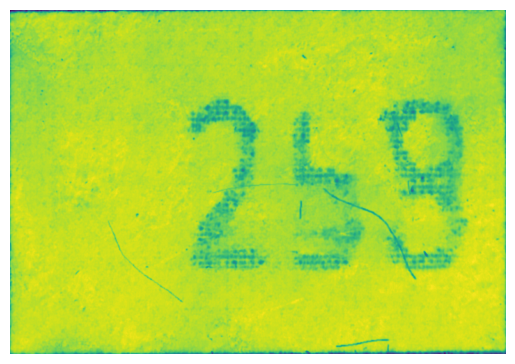

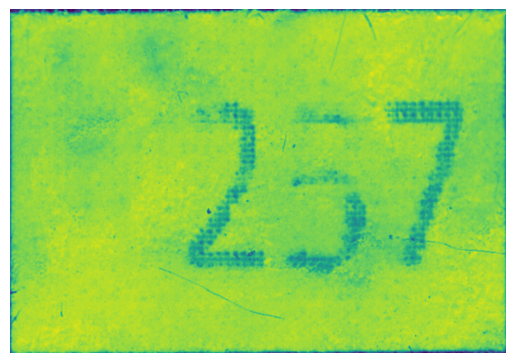

Contour area: 731328.0
Contour area: 390200.0
Contour area: 263186.0
Contour area: 12093.0
Contour area: 10020.0
Contour area: 3025.5
Contour area: 1921.5
Contour area: 1830.5
Contour area: 1516.5
Contour area: 1377.0
Contour area: 1353.5
Contour area: 1292.5
Contour area: 1168.0
Contour area: 1134.0
Contour area: 1126.0
Contour area: 978.0
Contour area: 949.0
Contour area: 677.0
Contour area: 660.5
Contour area: 575.0
Contour area: 503.5
Contour area: 495.5
Contour area: 387.0
Contour area: 381.5
Contour area: 347.0
Contour area: 265.5
Contour area: 254.5
Contour area: 233.0
Contour area: 171.5
Contour area: 154.5
Contour area: 119.0
Contour area: 101.5
Contour area: 93.5
Contour area: 87.0
Contour area: 85.5
Contour area: 81.0
Contour area: 79.5
Contour area: 70.0
Contour area: 66.5
Contour area: 59.5
Contour area: 58.5
Contour area: 52.5
Contour area: 50.5
Contour area: 45.0
Contour area: 44.0
Contour area: 44.0
Contour area: 44.0
Contour area: 42.0
Contour area: 42.0
Contour area: 

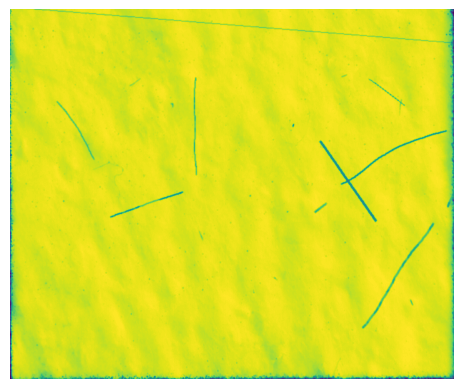

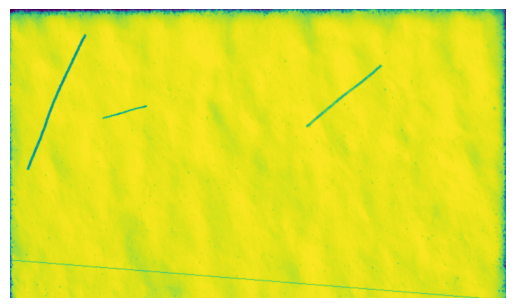

Contour area: 712209.0
Contour area: 365095.5
Contour area: 287768.0
Contour area: 8998.5
Contour area: 1105.0
Contour area: 1005.5
Contour area: 856.5
Contour area: 779.0
Contour area: 745.0
Contour area: 694.5
Contour area: 659.5
Contour area: 629.0
Contour area: 300.0
Contour area: 221.5
Contour area: 104.5
Contour area: 99.5
Contour area: 92.5
Contour area: 90.0
Contour area: 82.0
Contour area: 80.0
Contour area: 76.5
Contour area: 74.0
Contour area: 73.0
Contour area: 69.0
Contour area: 59.5
Contour area: 56.5
Contour area: 53.5
Contour area: 52.0
Contour area: 48.5
Contour area: 48.0
Contour area: 47.0
Contour area: 46.0
Contour area: 42.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 40.5
Contour area: 36.5
Contour area: 36.0
Contour area: 36.0
Contour area: 36.0
Contour area: 34.5
Contour area: 32.5
Contour area: 24.0
Contour area: 20.0
Contour area: 20.0
Contour area: 20.0
Contour area: 16.0
Cont

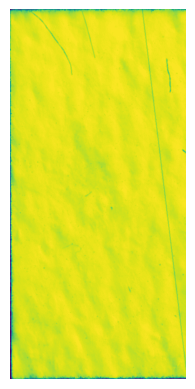

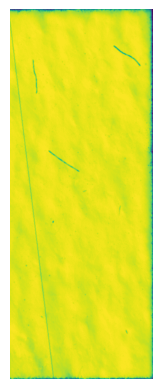

Contour area: 693504.5
Contour area: 608076.5
Contour area: 37813.0
Contour area: 29623.5
Contour area: 24554.5
Contour area: 11054.5
Contour area: 2085.0
Contour area: 1950.0
Contour area: 1796.5
Contour area: 1565.0
Contour area: 1497.0
Contour area: 1390.0
Contour area: 1230.0
Contour area: 716.5
Contour area: 530.0
Contour area: 444.0
Contour area: 381.0
Contour area: 349.5
Contour area: 341.5
Contour area: 319.0
Contour area: 198.0
Contour area: 194.5
Contour area: 150.0
Contour area: 117.0
Contour area: 99.0
Contour area: 96.5
Contour area: 92.0
Contour area: 90.5
Contour area: 85.0
Contour area: 84.5
Contour area: 75.5
Contour area: 74.5
Contour area: 71.0
Contour area: 67.5
Contour area: 57.5
Contour area: 57.0
Contour area: 57.0
Contour area: 57.0
Contour area: 54.5
Contour area: 54.0
Contour area: 52.5
Contour area: 52.0
Contour area: 51.5
Contour area: 51.5
Contour area: 49.5
Contour area: 48.0
Contour area: 46.5
Contour area: 42.5
Contour area: 42.5
Contour area: 42.0
Conto

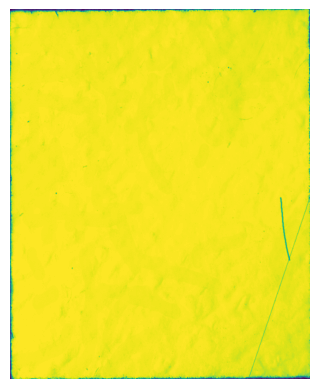

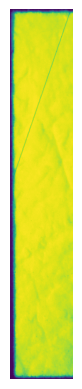

Contour area: 772775.0
Contour area: 340061.0
Contour area: 284075.0
Contour area: 53291.5
Contour area: 9256.5
Contour area: 8408.5
Contour area: 8133.5
Contour area: 7798.0
Contour area: 7421.5
Contour area: 5885.0
Contour area: 4816.0
Contour area: 4490.5
Contour area: 2776.5
Contour area: 2691.0
Contour area: 2388.5
Contour area: 1562.5
Contour area: 1480.5
Contour area: 1092.0
Contour area: 1009.0
Contour area: 953.0
Contour area: 871.0
Contour area: 828.5
Contour area: 501.5
Contour area: 462.5
Contour area: 347.0
Contour area: 316.5
Contour area: 311.5
Contour area: 258.0
Contour area: 234.0
Contour area: 224.5
Contour area: 215.0
Contour area: 205.5
Contour area: 200.0
Contour area: 172.5
Contour area: 153.0
Contour area: 143.0
Contour area: 142.0
Contour area: 141.5
Contour area: 139.5
Contour area: 138.0
Contour area: 134.0
Contour area: 131.0
Contour area: 129.0
Contour area: 125.0
Contour area: 123.0
Contour area: 120.0
Contour area: 118.5
Contour area: 118.0
Contour area: 

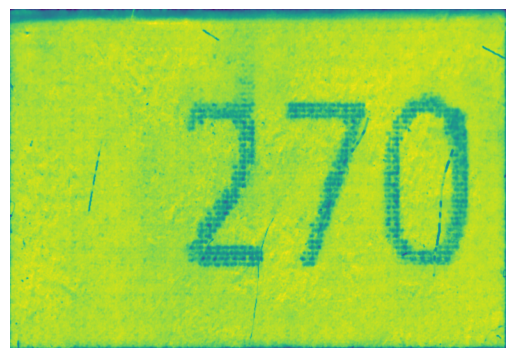

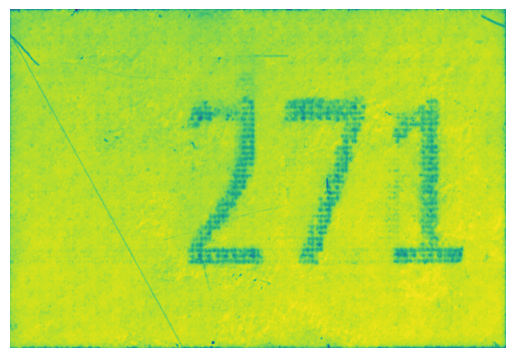

Contour area: 761032.5
Contour area: 335481.0
Contour area: 221707.0
Contour area: 112049.0
Contour area: 9126.5
Contour area: 8511.5
Contour area: 7531.5
Contour area: 5363.5
Contour area: 4947.5
Contour area: 3825.5
Contour area: 2924.0
Contour area: 2416.0
Contour area: 2251.0
Contour area: 2122.5
Contour area: 2121.5
Contour area: 1717.0
Contour area: 1671.5
Contour area: 1435.0
Contour area: 910.0
Contour area: 862.0
Contour area: 855.0
Contour area: 763.0
Contour area: 635.5
Contour area: 615.5
Contour area: 606.5
Contour area: 580.0
Contour area: 522.5
Contour area: 512.5
Contour area: 487.5
Contour area: 481.5
Contour area: 443.5
Contour area: 442.5
Contour area: 435.0
Contour area: 348.5
Contour area: 336.5
Contour area: 312.5
Contour area: 310.0
Contour area: 295.5
Contour area: 266.0
Contour area: 253.0
Contour area: 250.5
Contour area: 242.5
Contour area: 241.0
Contour area: 230.5
Contour area: 223.5
Contour area: 211.0
Contour area: 188.0
Contour area: 177.5
Contour area: 

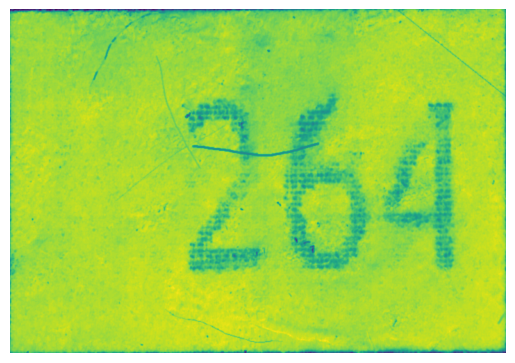

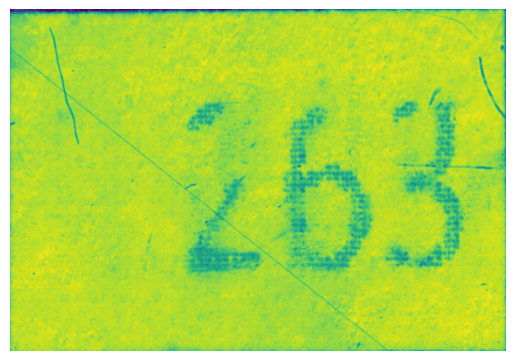

Contour area: 768927.5
Contour area: 342159.0
Contour area: 322418.0
Contour area: 8315.5
Contour area: 7744.0
Contour area: 6642.5
Contour area: 5399.5
Contour area: 5207.5
Contour area: 4634.0
Contour area: 4003.0
Contour area: 3980.0
Contour area: 3022.5
Contour area: 2665.0
Contour area: 2360.5
Contour area: 1328.5
Contour area: 1088.5
Contour area: 1051.5
Contour area: 1020.0
Contour area: 798.0
Contour area: 740.0
Contour area: 665.0
Contour area: 600.5
Contour area: 510.0
Contour area: 463.5
Contour area: 450.0
Contour area: 426.0
Contour area: 425.0
Contour area: 414.0
Contour area: 394.5
Contour area: 371.5
Contour area: 308.5
Contour area: 292.5
Contour area: 269.0
Contour area: 265.5
Contour area: 215.0
Contour area: 210.0
Contour area: 193.5
Contour area: 180.5
Contour area: 177.5
Contour area: 167.5
Contour area: 167.5
Contour area: 157.0
Contour area: 156.0
Contour area: 149.0
Contour area: 148.5
Contour area: 145.5
Contour area: 140.0
Contour area: 139.5
Contour area: 13

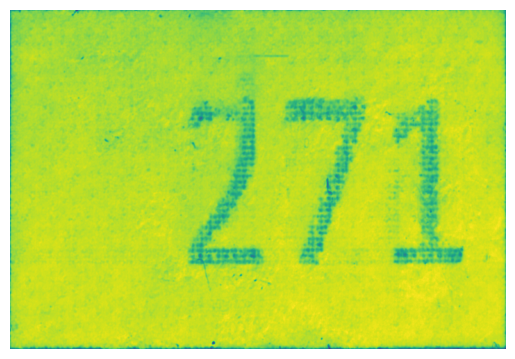

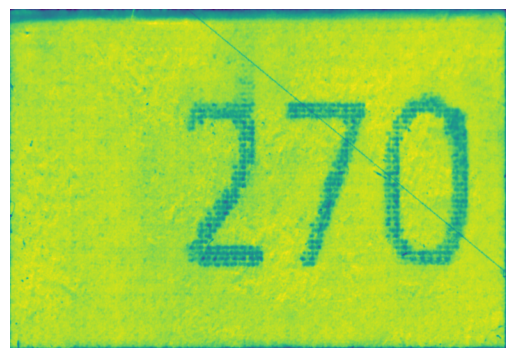

Contour area: 757800.5
Contour area: 342734.5
Contour area: 176049.5
Contour area: 148588.5
Contour area: 6198.0
Contour area: 3802.5
Contour area: 2318.5
Contour area: 2295.5
Contour area: 1999.5
Contour area: 1932.0
Contour area: 1916.5
Contour area: 1599.5
Contour area: 1386.0
Contour area: 1384.5
Contour area: 1376.0
Contour area: 1236.5
Contour area: 1105.0
Contour area: 1067.0
Contour area: 1065.5
Contour area: 862.0
Contour area: 784.5
Contour area: 753.0
Contour area: 571.0
Contour area: 564.5
Contour area: 544.5
Contour area: 525.0
Contour area: 491.5
Contour area: 477.5
Contour area: 455.5
Contour area: 453.5
Contour area: 450.5
Contour area: 423.0
Contour area: 422.5
Contour area: 419.5
Contour area: 365.0
Contour area: 358.0
Contour area: 349.5
Contour area: 333.5
Contour area: 317.5
Contour area: 299.0
Contour area: 297.5
Contour area: 288.0
Contour area: 285.5
Contour area: 263.0
Contour area: 231.0
Contour area: 230.0
Contour area: 226.0
Contour area: 223.0
Contour area:

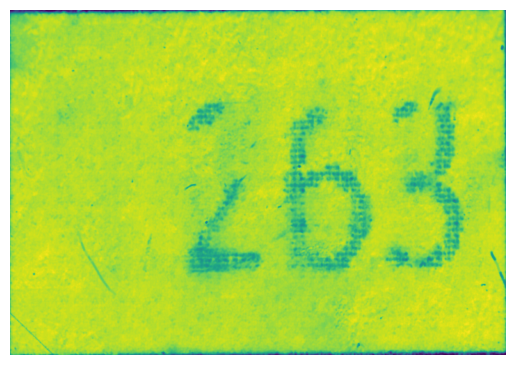

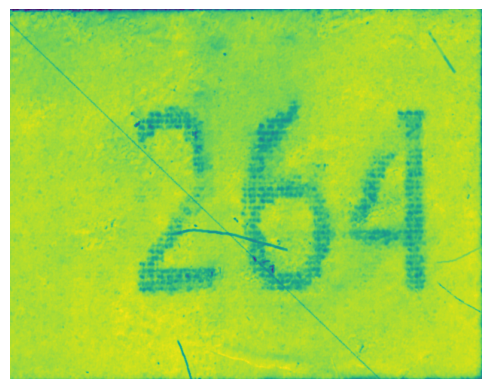

Contour area: 947251.5
Contour area: 304855.0
Contour area: 202601.0
Contour area: 109206.0
Contour area: 61675.5
Contour area: 58761.0
Contour area: 47706.0
Contour area: 17327.0
Contour area: 13401.5
Contour area: 13320.0
Contour area: 11877.0
Contour area: 11112.5
Contour area: 10000.5
Contour area: 4083.0
Contour area: 3938.5
Contour area: 3171.5
Contour area: 2727.5
Contour area: 1350.5
Contour area: 1174.5
Contour area: 1151.0
Contour area: 862.0
Contour area: 722.0
Contour area: 700.5
Contour area: 536.5
Contour area: 468.0
Contour area: 449.0
Contour area: 412.0
Contour area: 409.5
Contour area: 377.5
Contour area: 317.0
Contour area: 266.0
Contour area: 233.0
Contour area: 230.5
Contour area: 228.0
Contour area: 210.0
Contour area: 199.5
Contour area: 191.5
Contour area: 190.0
Contour area: 181.0
Contour area: 180.5
Contour area: 169.0
Contour area: 162.5
Contour area: 157.5
Contour area: 157.5
Contour area: 150.0
Contour area: 145.5
Contour area: 143.5
Contour area: 139.5
Con

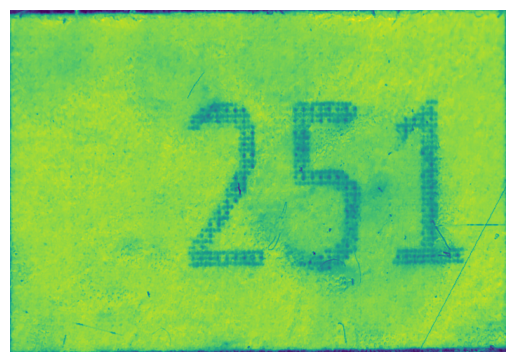

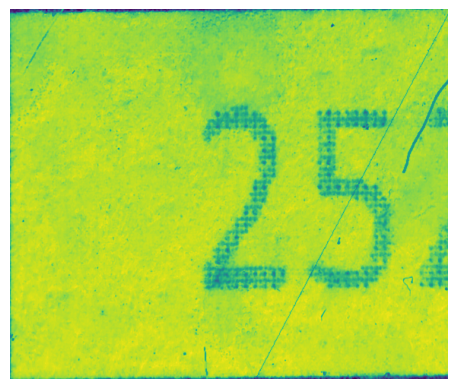

Contour area: 758277.5
Contour area: 345238.5
Contour area: 240807.0
Contour area: 84584.0
Contour area: 9281.0
Contour area: 6023.5
Contour area: 5112.0
Contour area: 4629.5
Contour area: 4530.0
Contour area: 3555.0
Contour area: 3024.0
Contour area: 1925.0
Contour area: 1754.5
Contour area: 1499.0
Contour area: 905.0
Contour area: 817.5
Contour area: 755.0
Contour area: 754.0
Contour area: 753.0
Contour area: 743.0
Contour area: 700.0
Contour area: 652.5
Contour area: 581.5
Contour area: 478.0
Contour area: 451.5
Contour area: 372.5
Contour area: 263.5
Contour area: 197.0
Contour area: 187.5
Contour area: 183.0
Contour area: 178.5
Contour area: 175.5
Contour area: 175.0
Contour area: 172.5
Contour area: 170.0
Contour area: 165.5
Contour area: 165.0
Contour area: 159.5
Contour area: 155.5
Contour area: 151.5
Contour area: 149.5
Contour area: 145.0
Contour area: 139.0
Contour area: 130.5
Contour area: 125.0
Contour area: 124.0
Contour area: 121.0
Contour area: 118.0
Contour area: 116.5

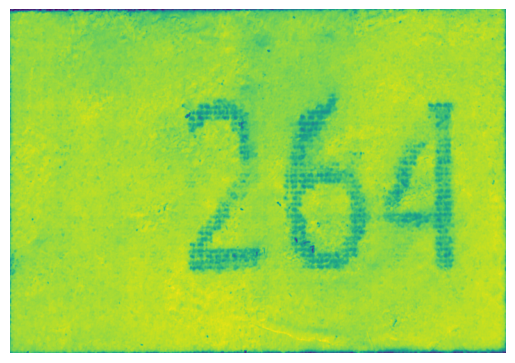

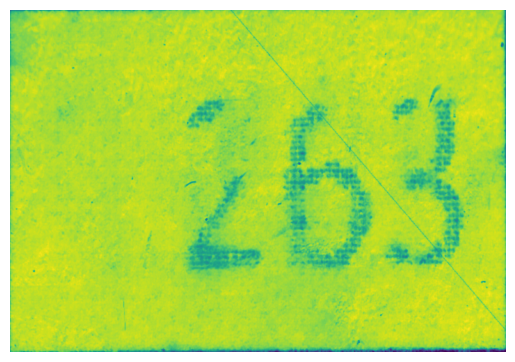

Contour area: 782275.5
Contour area: 336684.0
Contour area: 218603.0
Contour area: 109650.0
Contour area: 11638.5
Contour area: 11207.0
Contour area: 11095.0
Contour area: 8877.0
Contour area: 8511.0
Contour area: 7959.0
Contour area: 7828.5
Contour area: 6878.0
Contour area: 2047.5
Contour area: 2035.5
Contour area: 1838.5
Contour area: 1055.5
Contour area: 345.5
Contour area: 338.0
Contour area: 312.0
Contour area: 288.0
Contour area: 199.5
Contour area: 172.5
Contour area: 167.0
Contour area: 156.5
Contour area: 151.0
Contour area: 142.0
Contour area: 138.0
Contour area: 126.0
Contour area: 125.5
Contour area: 124.0
Contour area: 122.0
Contour area: 121.5
Contour area: 120.0
Contour area: 120.0
Contour area: 118.0
Contour area: 105.0
Contour area: 102.0
Contour area: 99.5
Contour area: 98.5
Contour area: 98.0
Contour area: 94.5
Contour area: 94.5
Contour area: 92.0
Contour area: 92.0
Contour area: 91.0
Contour area: 89.5
Contour area: 86.5
Contour area: 86.5
Contour area: 85.5
Conto

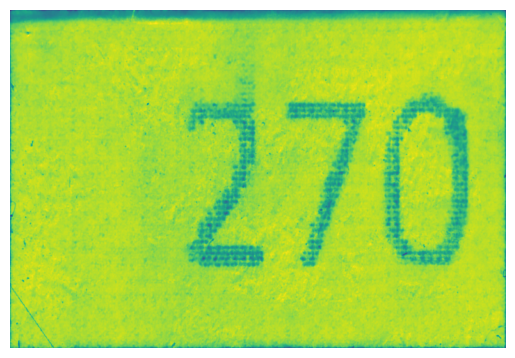

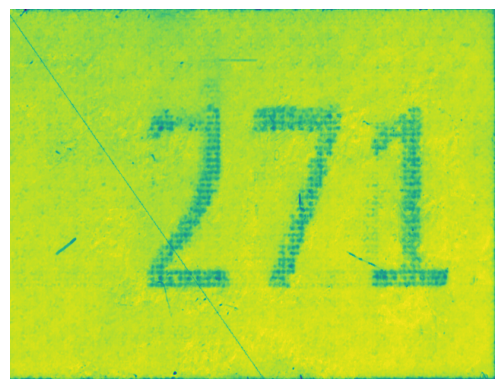

Contour area: 731796.5
Contour area: 534042.0
Contour area: 107488.0
Contour area: 1818.5
Contour area: 1358.0
Contour area: 1053.5
Contour area: 1048.5
Contour area: 859.5
Contour area: 761.5
Contour area: 754.5
Contour area: 673.0
Contour area: 596.5
Contour area: 513.0
Contour area: 425.5
Contour area: 407.5
Contour area: 398.0
Contour area: 397.5
Contour area: 348.5
Contour area: 341.0
Contour area: 299.0
Contour area: 276.0
Contour area: 273.5
Contour area: 247.0
Contour area: 241.0
Contour area: 239.0
Contour area: 237.0
Contour area: 212.5
Contour area: 210.0
Contour area: 199.5
Contour area: 187.5
Contour area: 143.0
Contour area: 110.0
Contour area: 107.5
Contour area: 104.0
Contour area: 81.0
Contour area: 71.0
Contour area: 68.0
Contour area: 66.0
Contour area: 59.5
Contour area: 51.5
Contour area: 50.5
Contour area: 50.0
Contour area: 44.5
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 41.0
Con

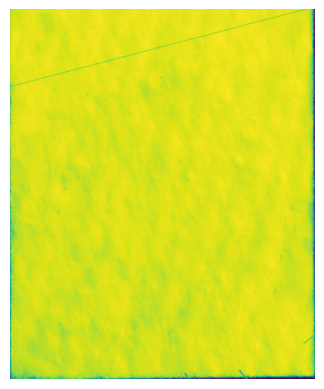

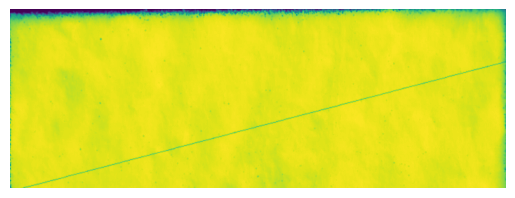

Contour area: 760021.0
Contour area: 330389.0
Contour area: 258798.5
Contour area: 78150.0
Contour area: 8947.0
Contour area: 6243.5
Contour area: 5396.5
Contour area: 5079.5
Contour area: 4753.0
Contour area: 4665.5
Contour area: 3467.5
Contour area: 3047.0
Contour area: 2811.0
Contour area: 2795.0
Contour area: 2339.5
Contour area: 1800.0
Contour area: 1748.0
Contour area: 1677.0
Contour area: 1418.5
Contour area: 1083.5
Contour area: 1067.5
Contour area: 1037.0
Contour area: 1014.0
Contour area: 967.0
Contour area: 868.0
Contour area: 652.5
Contour area: 641.5
Contour area: 556.0
Contour area: 435.0
Contour area: 361.5
Contour area: 342.5
Contour area: 335.5
Contour area: 290.0
Contour area: 285.5
Contour area: 284.0
Contour area: 249.0
Contour area: 232.0
Contour area: 229.0
Contour area: 217.0
Contour area: 192.5
Contour area: 186.0
Contour area: 184.5
Contour area: 182.5
Contour area: 165.5
Contour area: 157.5
Contour area: 154.0
Contour area: 149.0
Contour area: 145.0
Contour ar

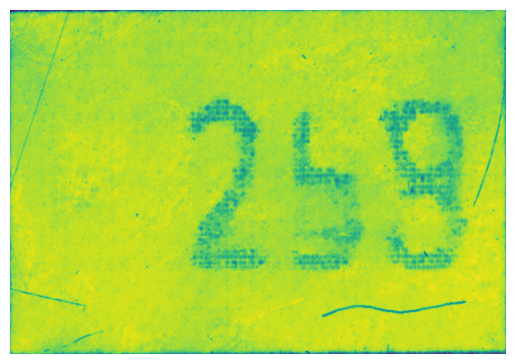

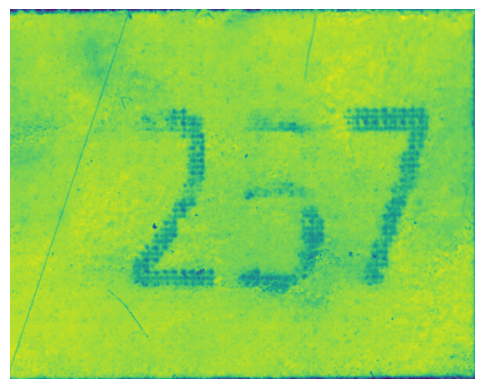

Contour area: 756366.0
Contour area: 342850.5
Contour area: 241039.0
Contour area: 80926.5
Contour area: 6372.5
Contour area: 5833.5
Contour area: 5166.5
Contour area: 3099.0
Contour area: 2882.5
Contour area: 2443.0
Contour area: 2199.5
Contour area: 1792.5
Contour area: 1726.5
Contour area: 1571.5
Contour area: 1215.0
Contour area: 1074.0
Contour area: 1048.5
Contour area: 472.5
Contour area: 393.0
Contour area: 353.0
Contour area: 331.5
Contour area: 290.5
Contour area: 249.5
Contour area: 232.0
Contour area: 226.5
Contour area: 220.5
Contour area: 219.0
Contour area: 209.5
Contour area: 208.0
Contour area: 195.0
Contour area: 189.5
Contour area: 178.5
Contour area: 173.5
Contour area: 170.5
Contour area: 167.5
Contour area: 163.0
Contour area: 153.0
Contour area: 145.0
Contour area: 141.5
Contour area: 137.5
Contour area: 127.5
Contour area: 125.0
Contour area: 124.0
Contour area: 122.5
Contour area: 121.5
Contour area: 117.0
Contour area: 112.5
Contour area: 111.5
Contour area: 11

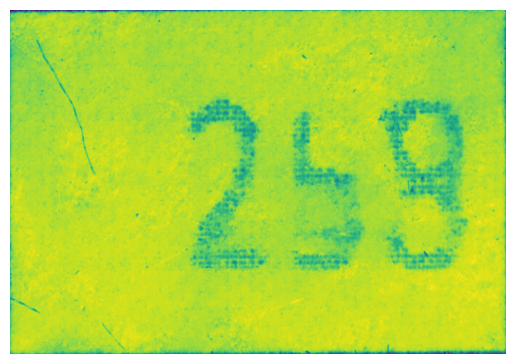

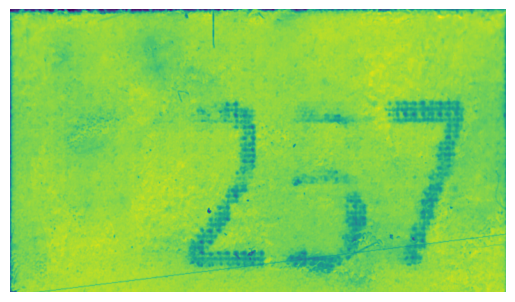

Contour area: 711459.5
Contour area: 494518.0
Contour area: 142944.5
Contour area: 10127.0
Contour area: 4734.5
Contour area: 4564.5
Contour area: 4494.0
Contour area: 2192.0
Contour area: 1797.5
Contour area: 1538.0
Contour area: 1482.5
Contour area: 1151.5
Contour area: 1080.5
Contour area: 662.0
Contour area: 609.5
Contour area: 564.5
Contour area: 481.5
Contour area: 336.5
Contour area: 251.5
Contour area: 189.0
Contour area: 145.5
Contour area: 139.0
Contour area: 131.0
Contour area: 105.0
Contour area: 103.5
Contour area: 98.0
Contour area: 87.5
Contour area: 85.5
Contour area: 79.5
Contour area: 70.0
Contour area: 67.5
Contour area: 55.0
Contour area: 52.5
Contour area: 52.5
Contour area: 52.0
Contour area: 52.0
Contour area: 51.5
Contour area: 49.5
Contour area: 49.0
Contour area: 48.5
Contour area: 48.5
Contour area: 47.0
Contour area: 47.0
Contour area: 46.5
Contour area: 45.0
Contour area: 44.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Conto

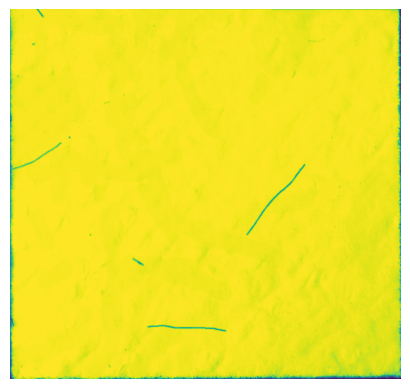

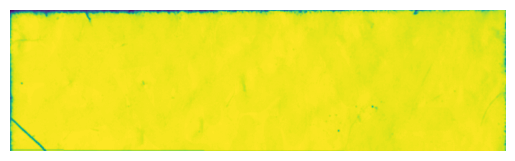

Contour area: 711630.5
Contour area: 472655.0
Contour area: 157115.0
Contour area: 14797.0
Contour area: 2085.0
Contour area: 1601.0
Contour area: 1565.0
Contour area: 1487.0
Contour area: 1324.5
Contour area: 1234.0
Contour area: 1157.0
Contour area: 1137.0
Contour area: 1109.0
Contour area: 888.0
Contour area: 716.5
Contour area: 497.5
Contour area: 454.0
Contour area: 382.5
Contour area: 350.0
Contour area: 349.5
Contour area: 319.0
Contour area: 275.5
Contour area: 245.0
Contour area: 229.0
Contour area: 198.5
Contour area: 198.0
Contour area: 194.5
Contour area: 152.0
Contour area: 118.0
Contour area: 102.0
Contour area: 99.0
Contour area: 96.5
Contour area: 92.0
Contour area: 90.5
Contour area: 85.5
Contour area: 84.5
Contour area: 75.5
Contour area: 71.0
Contour area: 69.5
Contour area: 67.5
Contour area: 58.0
Contour area: 57.5
Contour area: 57.0
Contour area: 55.5
Contour area: 54.5
Contour area: 54.0
Contour area: 52.5
Contour area: 52.0
Contour area: 51.5
Contour area: 48.5


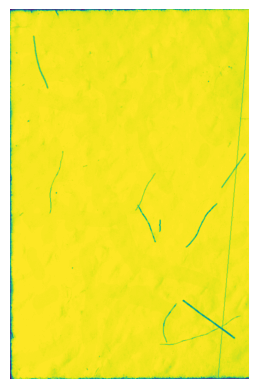

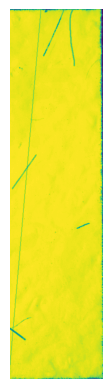

Contour area: 700310.5
Contour area: 376066.5
Contour area: 262916.5
Contour area: 9978.5
Contour area: 4675.0
Contour area: 2239.0
Contour area: 1786.0
Contour area: 1452.5
Contour area: 1226.0
Contour area: 1136.0
Contour area: 1073.5
Contour area: 943.0
Contour area: 799.0
Contour area: 481.0
Contour area: 338.5
Contour area: 196.5
Contour area: 189.0
Contour area: 127.0
Contour area: 121.0
Contour area: 105.0
Contour area: 93.0
Contour area: 90.5
Contour area: 87.5
Contour area: 82.5
Contour area: 76.0
Contour area: 67.5
Contour area: 63.0
Contour area: 58.5
Contour area: 57.5
Contour area: 55.0
Contour area: 53.5
Contour area: 52.5
Contour area: 49.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.0
Contour area: 47.5
Contour area: 47.0
Contour area: 46.5
Contour area: 46.0
Contour area: 45.5
Contour area: 42.0
Contour area: 42.0
Contour area: 42.0
Contour area: 41.0
Contour area: 36.0
Contour area: 36.0
Contour area: 32.5
Contour area: 32.5
Contour area: 29.0
Contour area:

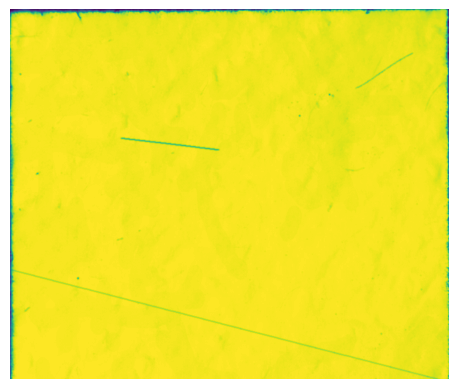

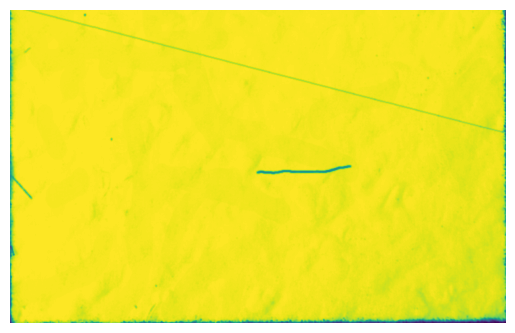

Contour area: 720796.0
Contour area: 619491.0
Contour area: 18310.5
Contour area: 8240.5
Contour area: 3215.5
Contour area: 2433.5
Contour area: 2196.5
Contour area: 1810.0
Contour area: 1468.0
Contour area: 1147.5
Contour area: 972.0
Contour area: 875.0
Contour area: 869.0
Contour area: 826.5
Contour area: 801.5
Contour area: 645.5
Contour area: 601.0
Contour area: 574.0
Contour area: 502.0
Contour area: 427.0
Contour area: 369.0
Contour area: 361.0
Contour area: 356.5
Contour area: 356.5
Contour area: 312.0
Contour area: 173.0
Contour area: 125.0
Contour area: 121.0
Contour area: 105.0
Contour area: 104.0
Contour area: 103.5
Contour area: 91.5
Contour area: 87.5
Contour area: 85.5
Contour area: 72.0
Contour area: 67.5
Contour area: 67.0
Contour area: 65.0
Contour area: 56.5
Contour area: 55.0
Contour area: 53.5
Contour area: 53.5
Contour area: 53.0
Contour area: 52.5
Contour area: 51.5
Contour area: 48.5
Contour area: 48.5
Contour area: 48.5
Contour area: 47.5
Contour area: 47.0
Cont

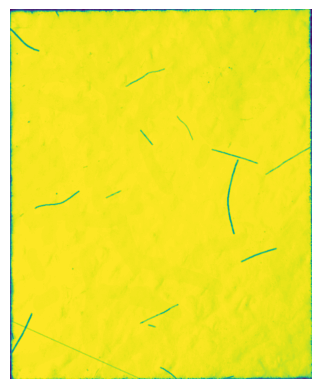

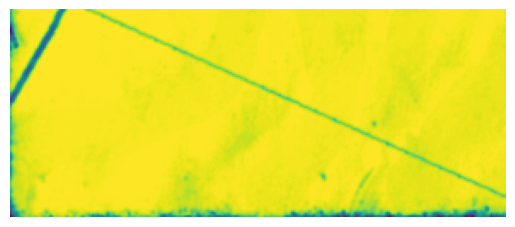

Contour area: 763280.5
Contour area: 344358.5
Contour area: 175641.0
Contour area: 160085.0
Contour area: 6483.5
Contour area: 5245.5
Contour area: 3643.0
Contour area: 3634.0
Contour area: 2717.0
Contour area: 2107.5
Contour area: 1556.5
Contour area: 1472.0
Contour area: 1339.0
Contour area: 1219.0
Contour area: 1125.5
Contour area: 1063.5
Contour area: 971.5
Contour area: 950.0
Contour area: 773.5
Contour area: 763.5
Contour area: 724.0
Contour area: 713.5
Contour area: 686.0
Contour area: 583.0
Contour area: 559.5
Contour area: 556.5
Contour area: 527.0
Contour area: 452.0
Contour area: 443.5
Contour area: 433.0
Contour area: 415.0
Contour area: 406.0
Contour area: 403.0
Contour area: 382.0
Contour area: 374.0
Contour area: 373.5
Contour area: 367.5
Contour area: 340.0
Contour area: 280.0
Contour area: 279.0
Contour area: 277.0
Contour area: 271.0
Contour area: 269.5
Contour area: 264.5
Contour area: 259.5
Contour area: 256.5
Contour area: 248.5
Contour area: 243.5
Contour area: 23

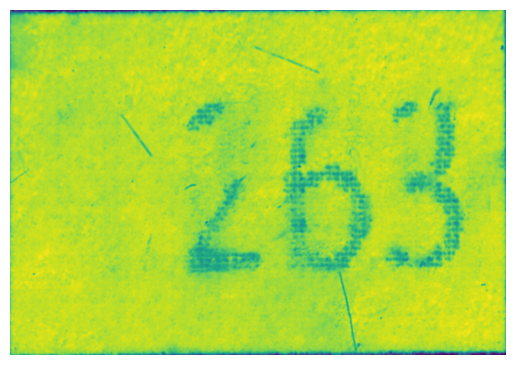

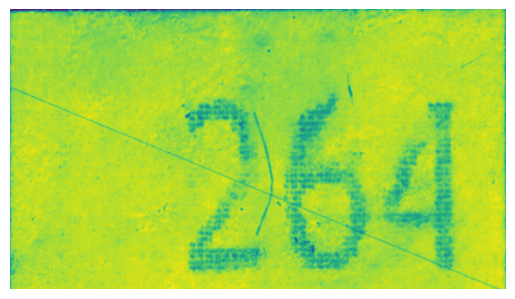

In [8]:
  
    
    
current_directory = os.getcwd()
# Go back one directory
parent_directory = os.path.dirname(current_directory)
print('Current Directory', current_directory)

rawImages = os.path.join(parent_directory, 'Data', 'synth', 'images', '')
rawMasks = os.path.join(parent_directory, 'Data', 'synth', 'masks', '')




# one_box_files = ["wash"]

# directory = '..\Data\Raw'
# target_directory = '..\Data\Prepared'

# # Get all filenames in the directory
imageFilenames = os.listdir(rawImages)

# pattern = r"\b(" + "|".join(one_box_files) + r")\b"

# Print the filenames
for filename in imageFilenames:
    ImageFile = os.path.join(rawImages, filename)
    maskFilename = ImageFile.replace('image', 'mask')
    
    MaskFile = os.path.join(rawMasks, maskFilename)
    
    #target_file = os.path.join(target_directory, filename)
    
        # read image
    img = cv2.imread(ImageFile, cv2.IMREAD_UNCHANGED)
    mask = cv2.imread(MaskFile, cv2.IMREAD_UNCHANGED)
        
    
    myImagePrep = imagePreparation(img, mask, 2)
    myImagePrep.setTransformation()
    myImagePrep.setContours()
    myImagePrep.cropping()